In [36]:
import numpy as np
import pandas as pd
import scanpy as sc
import harmonypy as hm
import anndata
import os
import scvi
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')


In [37]:
# set output directory
fig_dir = "/dfs7/swaruplab/smorabit/collab/woodlab/cocaine_mouse_2021/Nurr2c_vs_GFP/figures/"
data_dir = "/dfs7/swaruplab/smorabit/collab/woodlab/cocaine_mouse_2021/Nurr2c_vs_GFP/data/"

sc.settings.figdir = fig_dir

## Re-load the final dataset:

In [38]:
# save the annotated data object
adata = sc.read_h5ad('{}harmony_annotated_integration.h5ad'.format(data_dir))


## Combine the original dataset with the April 2023 batch (post-QC)

In [53]:
# load the post-QC unprocessed dataset
adata_orig = sc.read_h5ad('/dfs7/swaruplab/smorabit/collab/woodlab/cocaine_mouse_2021/Nurr2c_vs_GFP/data/initial_unprocessed.h5ad')
adata_orig


AnnData object with n_obs × n_vars = 73960 × 32285
    obs: 'doublet_scores', 'doublets', 'Sample', 'orig_barcode', 'batch', 'barcode', 'Assignment', 'Sample.No.', 'Name..Wood.lab.marking.', 'Group', 'Index', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden_old', 'clusternum_anno_old', 'celltype_old'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'Sample_colors'
    layers: 'counts'

In [54]:
# load the post-QC unprocessed dataset
adata_new = sc.read_h5ad('/dfs7/swaruplab/smorabit/collab/woodlab/cocaine_mouse_2021/Nurr2c_vs_GFP/data/initial_unprocessed_april2023.h5ad')
adata_new

# load the processed dataset
adata_processed = sc.read_h5ad('/dfs7/swaruplab/smorabit/collab/woodlab/cocaine_mouse_2021/Nurr2c_vs_GFP/data/harmony_processed_april2023.h5ad')


In [55]:
meta = adata_processed.obs[['barcode', 'leiden', 'cell_type']]
meta = meta.rename({'celltype':'cell_type'})
meta.columns = ['barcode'] + [i + "_old" for i in meta.columns[1:]]

In [56]:
temp = adata_new.obs.merge(
    meta, how='left',
    on = 'barcode'
)


temp.index = temp.barcode
adata_new.obs = temp
adata_new.obs.index.name = None



In [57]:
adata_new.obs

,doublet_scores,doublets,Sample_num,orig_barcode,batch,barcode,Group,Sample,Assignment,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_old,cell_type_old
TGGAGGACAGTTTCGA-1-0,0.037883,Singlet,4,TGGAGGACAGTTTCGA-1,0,TGGAGGACAGTTTCGA-1-0,NN,Group3-4,Group3,4127,9914.0,10.0,0.100867,11,EPD
CGCAGGTCATACCACA-1-0,0.135699,Singlet,4,CGCAGGTCATACCACA-1,0,CGCAGGTCATACCACA-1-0,NN,Group3-4,Group3,3930,9046.0,2.0,0.022109,9,MHb-Neuron
TGAACGTAGCGGTATG-1-0,0.125867,Singlet,4,TGAACGTAGCGGTATG-1,0,TGAACGTAGCGGTATG-1-0,NN,Group3-4,Group3,4041,9415.0,28.0,0.297398,NaN,NaN
ACCGTTCGTCCAGGTC-1-0,0.103930,Singlet,4,ACCGTTCGTCCAGGTC-1,0,ACCGTTCGTCCAGGTC-1-0,NN,Group3-4,Group3,4188,9663.0,58.0,0.600228,NaN,NaN
ATTGTTCAGAGCGACT-1-0,0.048276,Singlet,4,ATTGTTCAGAGCGACT-1,0,ATTGTTCAGAGCGACT-1-0,NN,Group3-4,Group3,3623,9705.0,0.0,0.000000,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CGCATGGAGCGTCTCG-1-7,0.034205,Singlet,2,CGCATGGAGCGTCTCG-1,7,CGCATGGAGCGTCTCG-1-7,NN,Group3-2,Group3,373,451.0,5.0,1.108647,20,ASC
TTTATGCCAGAGTGTG-1-7,0.006083,Singlet,2,TTTATGCCAGAGTGTG-1,7,TTTATGCCAGAGTGTG-1-7,NN,Group3-2,Group3,395,533.0,0.0,0.000000,NaN,NaN
CGCGTGATCCCGAATA-1-7,0.054963,Singlet,2,CGCGTGATCCCGAATA-1,7,CGCGTGATCCCGAATA-1-7,NN,Group3-2,Group3,419,537.0,0.0,0.000000,NaN,NaN
CAGAGCCGTGTCATCA-1-7,0.032131,Singlet,2,CAGAGCCGTGTCATCA-1,7,CAGAGCCGTGTCATCA-1-7,NN,Group3-2,Group3,268,362.0,0.0,0.000000,0,ODC


In [58]:
cols_keep = ['doublet_scores', 'Sample', 'barcode', 'Assignment', 'Group', 'n_genes_by_counts','total_counts', 'total_counts_mt','pct_counts_mt', 'leiden_old', 'cell_type_old']


In [59]:
adata_orig.obs = adata_orig.obs[[x for x in adata_orig.obs.columns if x in cols_keep]]
adata_new.obs = adata_new.obs[[x for x in adata_new.obs.columns if x in cols_keep]]

In [60]:
adata = adata_orig.concatenate([adata_new])
adata.shape

/data/homezvol1/smorabit/swaruplab/smorabit/bin/software/alsppg_miniconda3/envs/torch/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


(164455, 32285)

In [61]:
# save unprocessed data:
adata.obs.index.name = None
adata.write('{}initial_unprocessed_integrated2023.h5ad'.format(data_dir))

## Clustering analysis

In [11]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(
    adata,
    flavor="seurat_v3",
    n_top_genes=3000,
    layer="counts",
    batch_key="Assignment",
    subset=False
)

In [12]:
sc.pp.scale(adata, max_value=10)

In [13]:
sc.tl.pca(adata, svd_solver='arpack', use_highly_variable=True)

In [14]:
sc.external.pp.harmony_integrate(adata, key = 'Assignment')

2023-04-17 10:53:44,972 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2023-04-17 10:54:41,824 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2023-04-17 10:55:38,056 - harmonypy - INFO - Iteration 3 of 10
INFO:harmonypy:Iteration 3 of 10
2023-04-17 10:56:36,563 - harmonypy - INFO - Iteration 4 of 10
INFO:harmonypy:Iteration 4 of 10
2023-04-17 10:57:40,634 - harmonypy - INFO - Iteration 5 of 10
INFO:harmonypy:Iteration 5 of 10
2023-04-17 10:58:41,827 - harmonypy - INFO - Iteration 6 of 10
INFO:harmonypy:Iteration 6 of 10
2023-04-17 10:59:18,357 - harmonypy - INFO - Iteration 7 of 10
INFO:harmonypy:Iteration 7 of 10
2023-04-17 11:00:14,441 - harmonypy - INFO - Iteration 8 of 10
INFO:harmonypy:Iteration 8 of 10
2023-04-17 11:01:10,534 - harmonypy - INFO - Iteration 9 of 10
INFO:harmonypy:Iteration 9 of 10
2023-04-17 11:02:07,004 - harmonypy - INFO - Iteration 10 of 10
INFO:harmonypy:Iteration 10 of 10
2023-04-17 11:03:03,025 - harmonypy - 

In [15]:
sc.pp.neighbors(adata, use_rep = 'X_pca_harmony', n_neighbors=15, n_pcs=30, metric='cosine')


In [16]:
sc.tl.umap(adata, min_dist=0.2, method='umap')

In [30]:
sc.tl.leiden(adata, resolution=2)

#compute dendrogram for the dotplot:
sc.tl.dendrogram(adata, 'leiden')

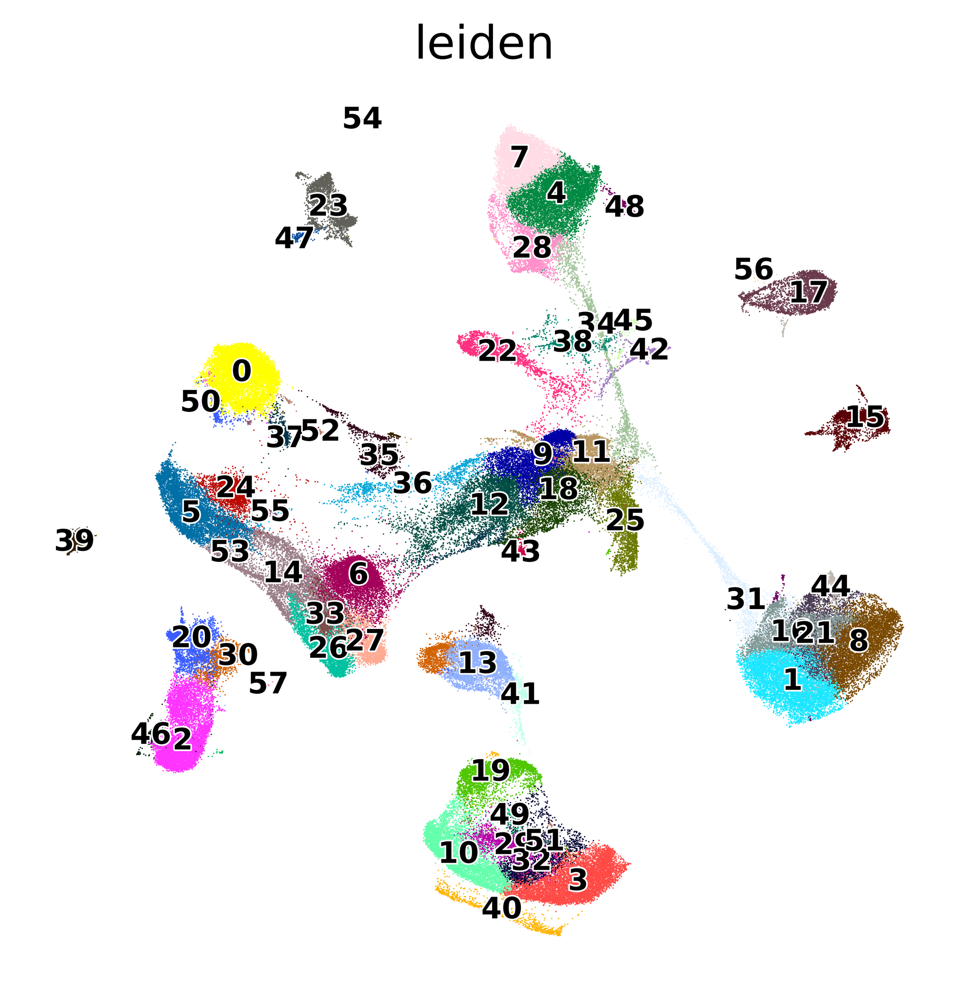

In [31]:
sc.settings.set_figure_params(dpi=500, dpi_save=200, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['leiden'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    add_outline=False
)


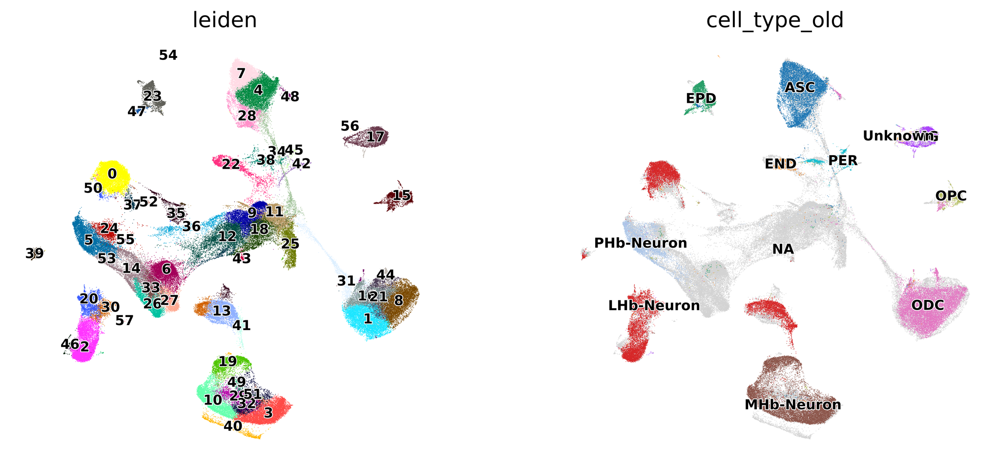

In [32]:
sc.settings.set_figure_params(dpi=500, dpi_save=200, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['leiden', 'cell_type_old'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    add_outline=False
)


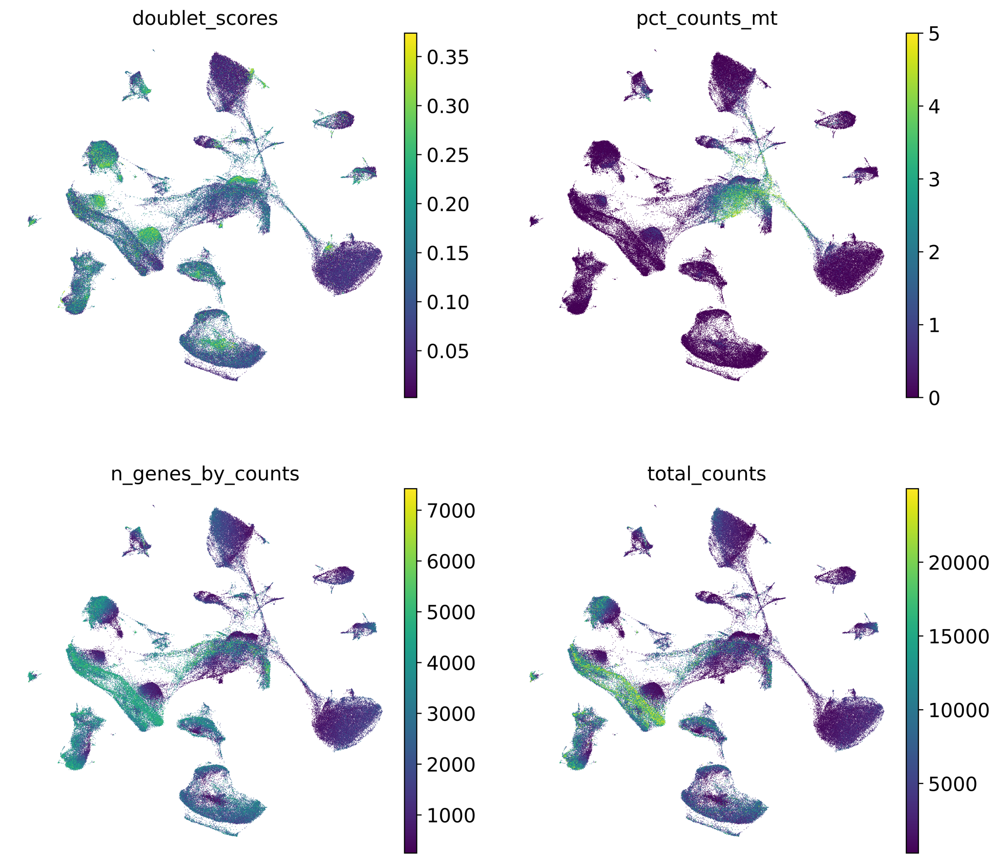

In [33]:
sc.pl.umap(
    adata,
    color=['doublet_scores', 'pct_counts_mt', 'n_genes_by_counts', 'total_counts'],
    frameon=False, 
    ncols=2
)

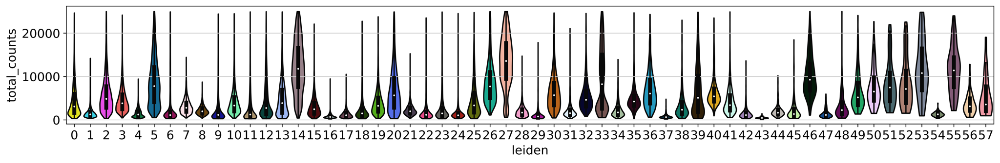

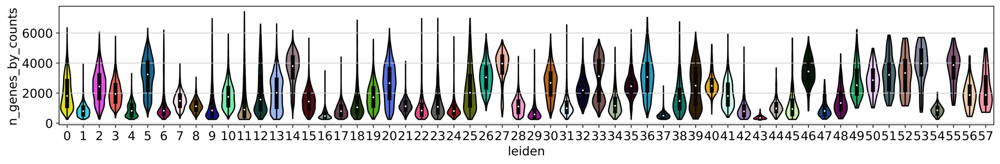

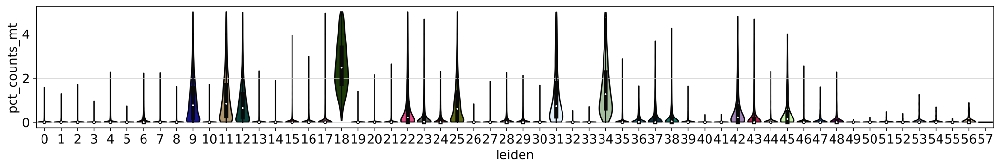

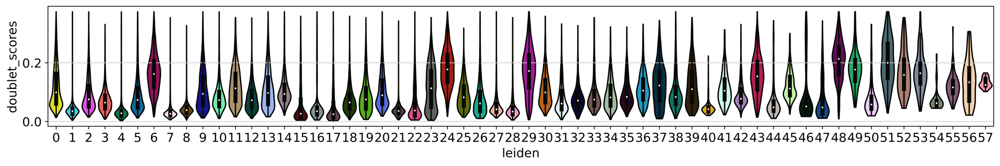

In [35]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(15,2.5), facecolor='white')
sc.pl.violin(adata,[ 'total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False)
sc.pl.violin(adata,[ 'n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False)
sc.pl.violin(adata,[ 'doublet_scores'], inner='box', size=0,  groupby='leiden', multi_panel=False)

categories: 0, 1, 2, etc.
var_group_labels: MF-ODC, Mature ODC, Neuron, etc.


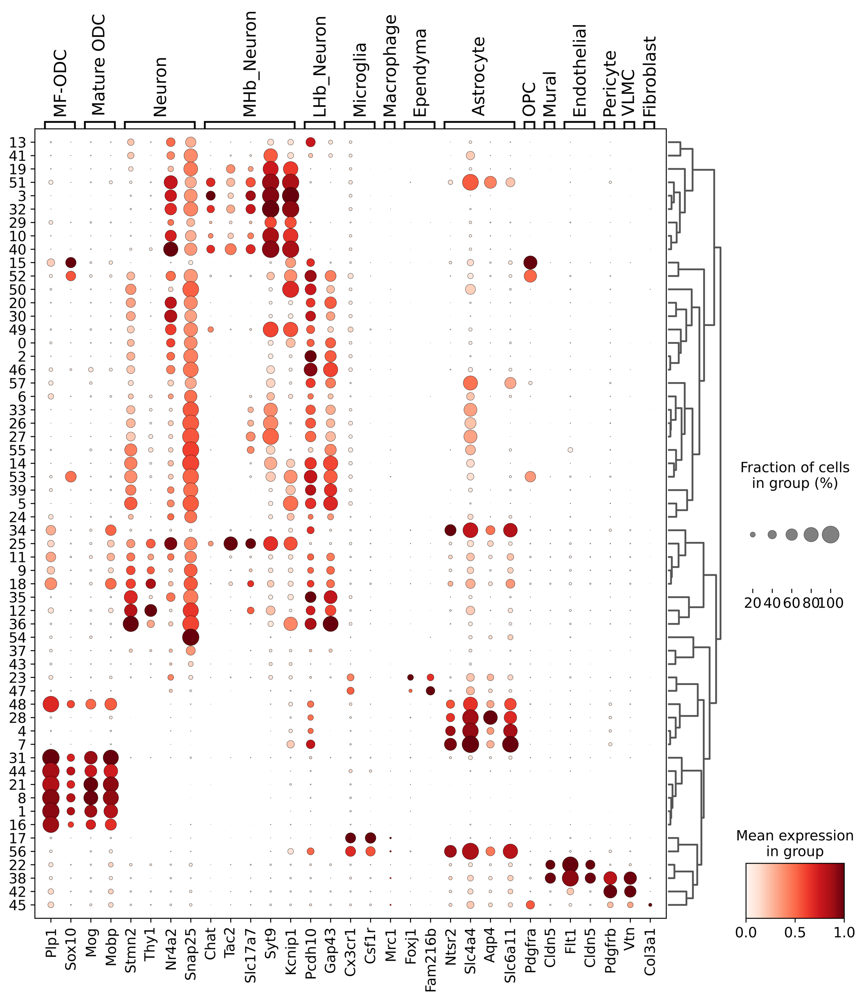

In [36]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,12), facecolor='white')

# marker genes from dotplot:
marker_dict = {
    'MF-ODC' : ['Plp1', 'Sox10'],
    'Mature ODC' : ['Mog', 'Mobp'],
    'Neuron' : ['Stmn2', 'Thy1', 'Nr4a2', 'Snap25', ],
    'MHb_Neuron': ['Chat', 'Tac2', 'Slc17a7', 'Syt9', 'Kcnip1'],
    'LHb_Neuron': ['Pcdh10', 'Gap43'],
    'Microglia': ['Cx3cr1', 'Csf1r'],
    'Macrophage': ['Mrc1'],
    'Ependyma':['Foxj1', 'Fam216b'],
    'Astrocyte' : ['Ntsr2', 'Slc4a4', 'Aqp4', 'Slc6a11'],
    'OPC' : ['Pdgfra'],
    'Mural' : ['Cldn5'],
    'Endothelial': ['Flt1', 'Cldn5'],
    'Pericyte': ['Pdgfrb'],
    'VLMC': ['Vtn'],
    'Fibroblast': ['Col3a1']
}

sc.pl.dotplot(adata, marker_dict, groupby='leiden', figsize=(12,12), standard_scale='var',  dendrogram=True)

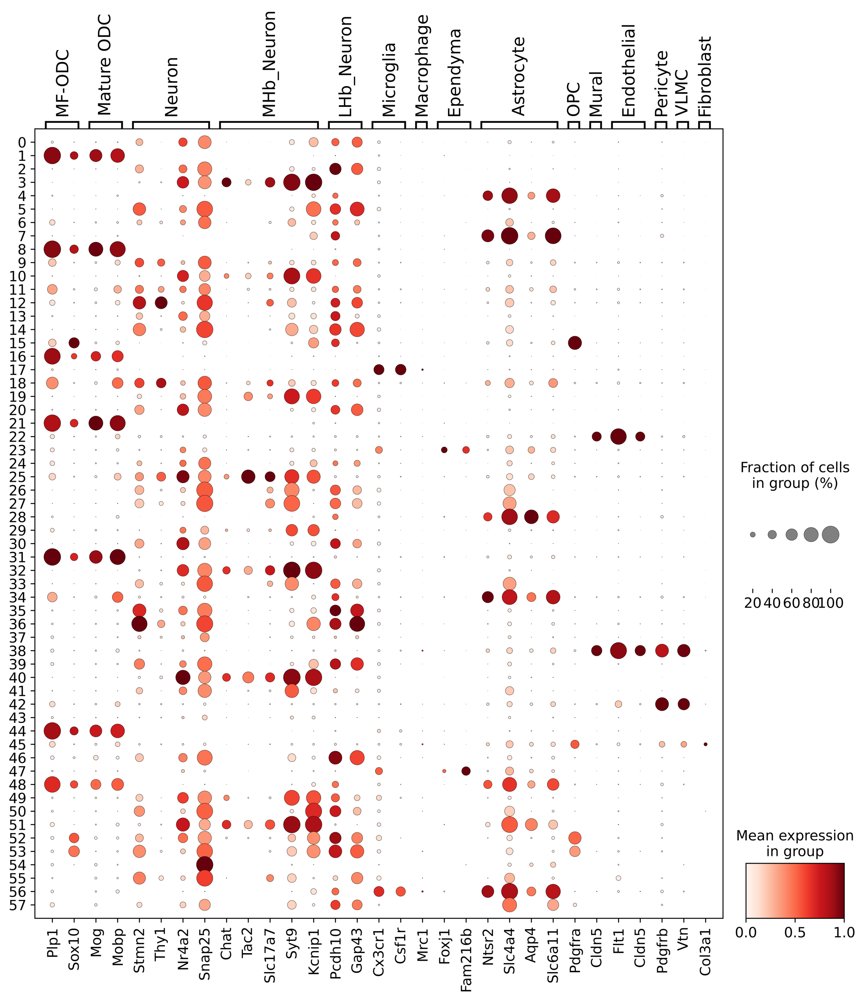

In [37]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,12), facecolor='white')

# marker genes from dotplot:
marker_dict = {
    'MF-ODC' : ['Plp1', 'Sox10'],
    'Mature ODC' : ['Mog', 'Mobp'],
    'Neuron' : ['Stmn2', 'Thy1', 'Nr4a2', 'Snap25', ],
    'MHb_Neuron': ['Chat', 'Tac2', 'Slc17a7', 'Syt9', 'Kcnip1'],
    'LHb_Neuron': ['Pcdh10', 'Gap43'],
    'Microglia': ['Cx3cr1', 'Csf1r'],
    'Macrophage': ['Mrc1'],
    'Ependyma':['Foxj1', 'Fam216b'],
    'Astrocyte' : ['Ntsr2', 'Slc4a4', 'Aqp4', 'Slc6a11'],
    'OPC' : ['Pdgfra'],
    'Mural' : ['Cldn5'],
    'Endothelial': ['Flt1', 'Cldn5'],
    'Pericyte': ['Pdgfrb'],
    'VLMC': ['Vtn'],
    'Fibroblast': ['Col3a1']
}

sc.pl.dotplot(adata, marker_dict, groupby='leiden', figsize=(12,12), standard_scale='var',  dendrogram=False)

In [50]:
clusters_to_remove = [
    '9', 
    '11',
    '12', 
    '18', # highest MT
    '6', # doublet
    '24', # doublet
    '29', # doublet
    '34',
    '48',
    '49',
    '51',
    '52',
    '53',
    '55',
    '56',
    '57'
]

/data/homezvol1/smorabit/swaruplab/smorabit/bin/software/alsppg_miniconda3/envs/torch/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


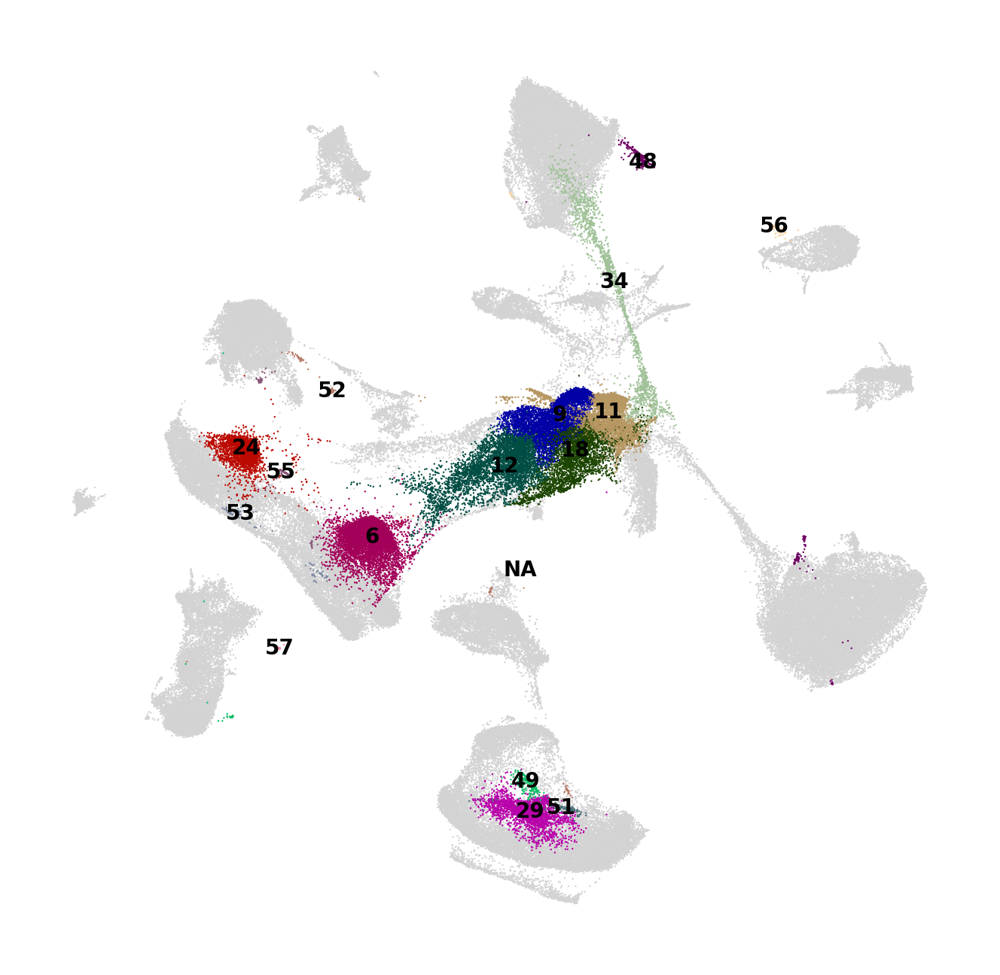

In [51]:
# clusters to remove based on low qc / conflicting markers
sc.settings.set_figure_params(dpi=200, figsize=(4,4), facecolor='white')
sc.pl.umap( 
    adata,
    color=["leiden"], 
    groups=clusters_to_remove,
    frameon=False, 
    legend_fontsize=5, 
    legend_loc='on data', 
    title=''
)


In [52]:
# save data
adata.obs.index.name = None
adata.write('{}initial_harmony_integrated2023.h5ad'.format(data_dir))

## Analyze again with additional filtering

In [80]:
adata_unprocessed = sc.read_h5ad('{}initial_unprocessed_integrated2023.h5ad'.format(data_dir))
adata = sc.read_h5ad('{}initial_harmony_integrated2023.h5ad'.format(data_dir))

In [81]:
adata = adata[~adata.obs.leiden.isin(clusters_to_remove)]


In [82]:
adata_unprocessed = adata_unprocessed[adata.obs.index]
adata_unprocessed.obs = adata.obs

In [83]:
adata = adata_unprocessed
adata.shape

(131644, 32285)

In [86]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(
    adata,
    flavor="seurat_v3",
    n_top_genes=3000,
    layer="counts",
    batch_key="Assignment",
    subset=False
)

In [87]:
sc.pp.scale(adata, max_value=10)

In [88]:
sc.tl.pca(adata, svd_solver='arpack', use_highly_variable=True)

In [89]:
sc.external.pp.harmony_integrate(adata, key = 'Assignment')

2023-04-17 15:03:45,275 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2023-04-17 15:04:32,226 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2023-04-17 15:05:18,970 - harmonypy - INFO - Iteration 3 of 10
INFO:harmonypy:Iteration 3 of 10
2023-04-17 15:06:04,986 - harmonypy - INFO - Iteration 4 of 10
INFO:harmonypy:Iteration 4 of 10
2023-04-17 15:06:50,982 - harmonypy - INFO - Iteration 5 of 10
INFO:harmonypy:Iteration 5 of 10
2023-04-17 15:07:36,506 - harmonypy - INFO - Iteration 6 of 10
INFO:harmonypy:Iteration 6 of 10
2023-04-17 15:08:22,166 - harmonypy - INFO - Iteration 7 of 10
INFO:harmonypy:Iteration 7 of 10
2023-04-17 15:09:06,786 - harmonypy - INFO - Iteration 8 of 10
INFO:harmonypy:Iteration 8 of 10
2023-04-17 15:09:52,042 - harmonypy - INFO - Iteration 9 of 10
INFO:harmonypy:Iteration 9 of 10
2023-04-17 15:10:36,415 - harmonypy - INFO - Iteration 10 of 10
INFO:harmonypy:Iteration 10 of 10
2023-04-17 15:11:21,525 - harmonypy - 

In [90]:
sc.pp.neighbors(adata, use_rep = 'X_pca_harmony', n_neighbors=15, n_pcs=30, metric='cosine')


In [91]:
sc.tl.umap(adata, min_dist=0.25, method='umap')

In [92]:
# re-name the old leiden 
adata.obs = adata.obs.rename({'leiden':'leiden_orig'})

In [93]:
sc.tl.leiden(adata, resolution=1.25)

#compute dendrogram for the dotplot:
sc.tl.dendrogram(adata, 'leiden')

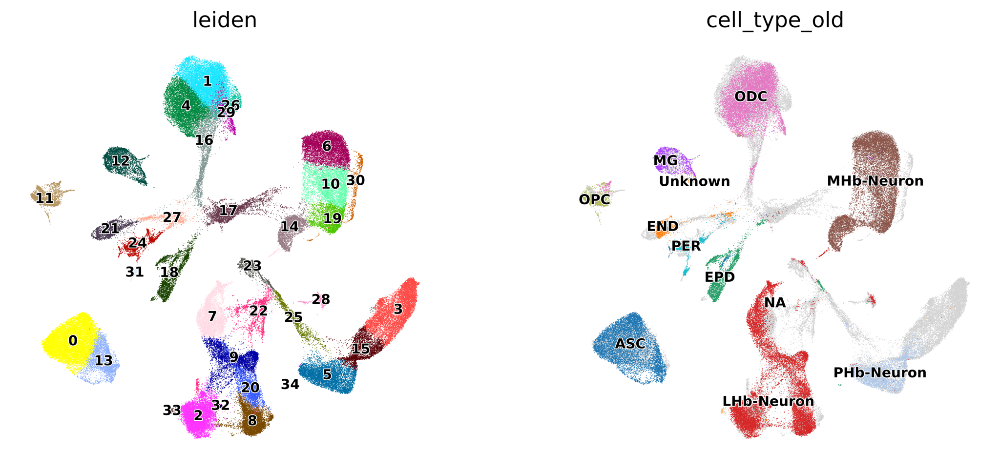

In [94]:
sc.settings.set_figure_params(dpi=500, dpi_save=200, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['leiden', 'cell_type_old'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9
   # title='',
    #save='_leiden_filtered_april2023.pdf'
)


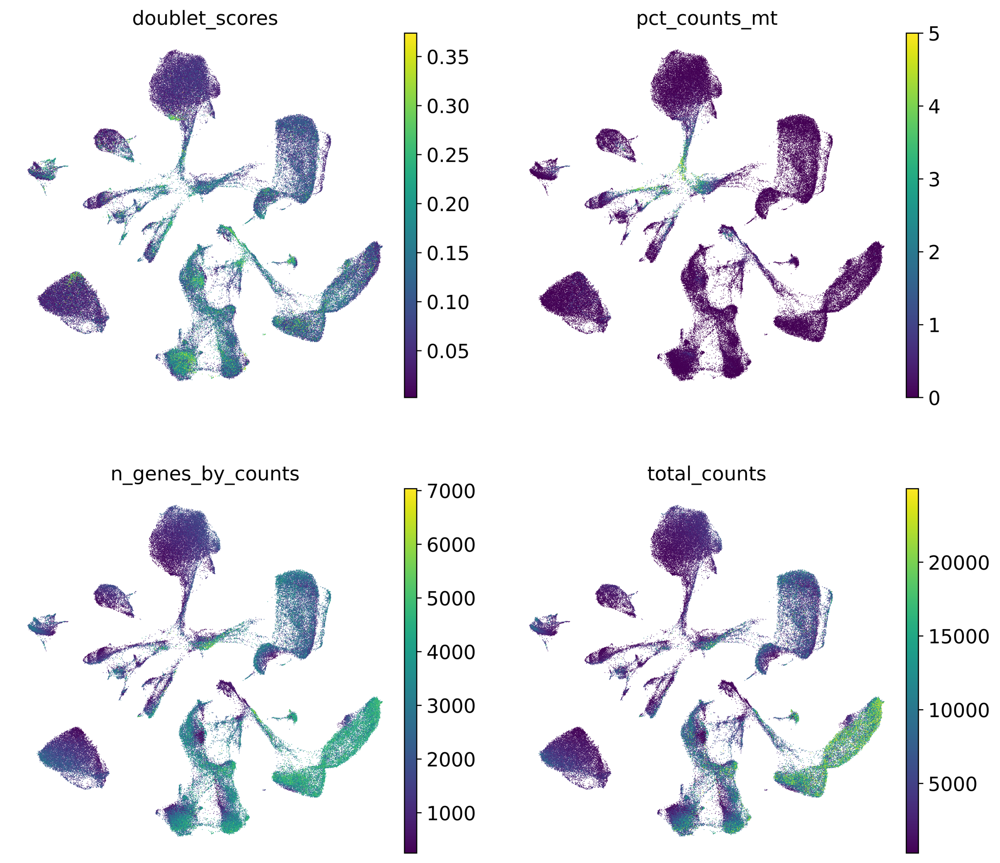

In [99]:
sc.settings.set_figure_params(dpi=500, dpi_save=200, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata,
    color=['doublet_scores', 'pct_counts_mt', 'n_genes_by_counts', 'total_counts'],
    frameon=False, 
    ncols=2, 
    #save='_qc_april2023.pdf'
)

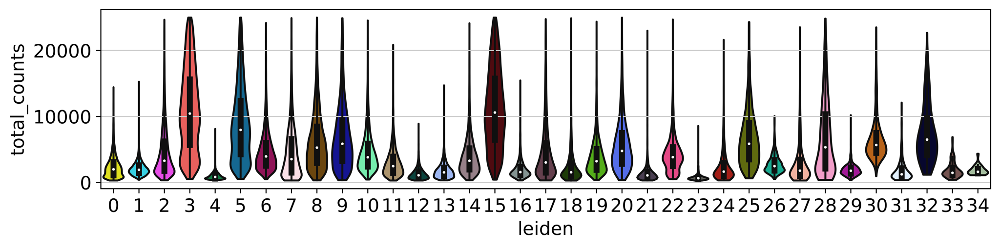

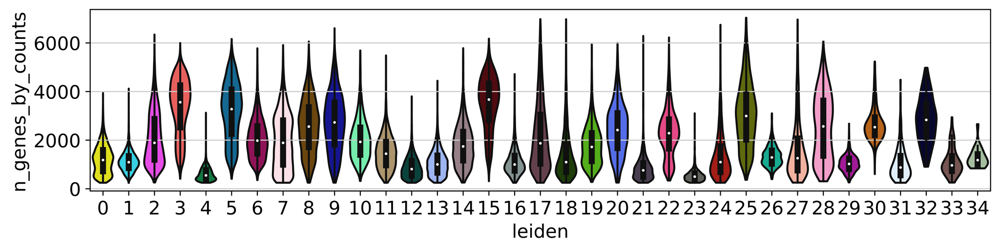

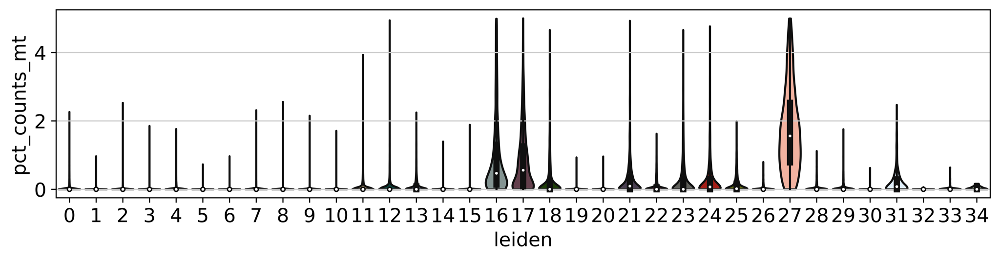

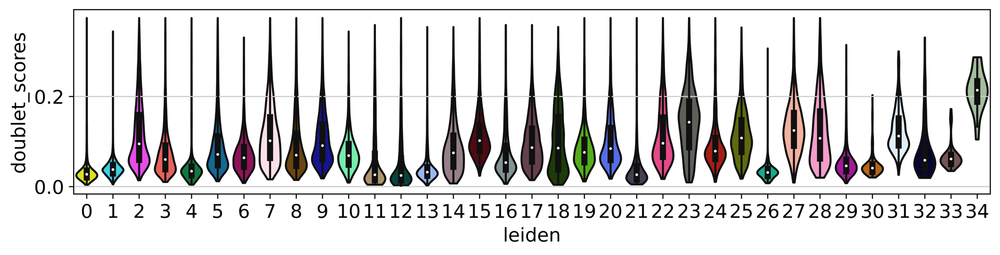

In [95]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata,[ 'total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False)
sc.pl.violin(adata,[ 'n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False)
sc.pl.violin(adata,[ 'doublet_scores'], inner='box', size=0,  groupby='leiden', multi_panel=False)

categories: 0, 1, 2, etc.
var_group_labels: MF-ODC, Mature ODC, Neuron, etc.


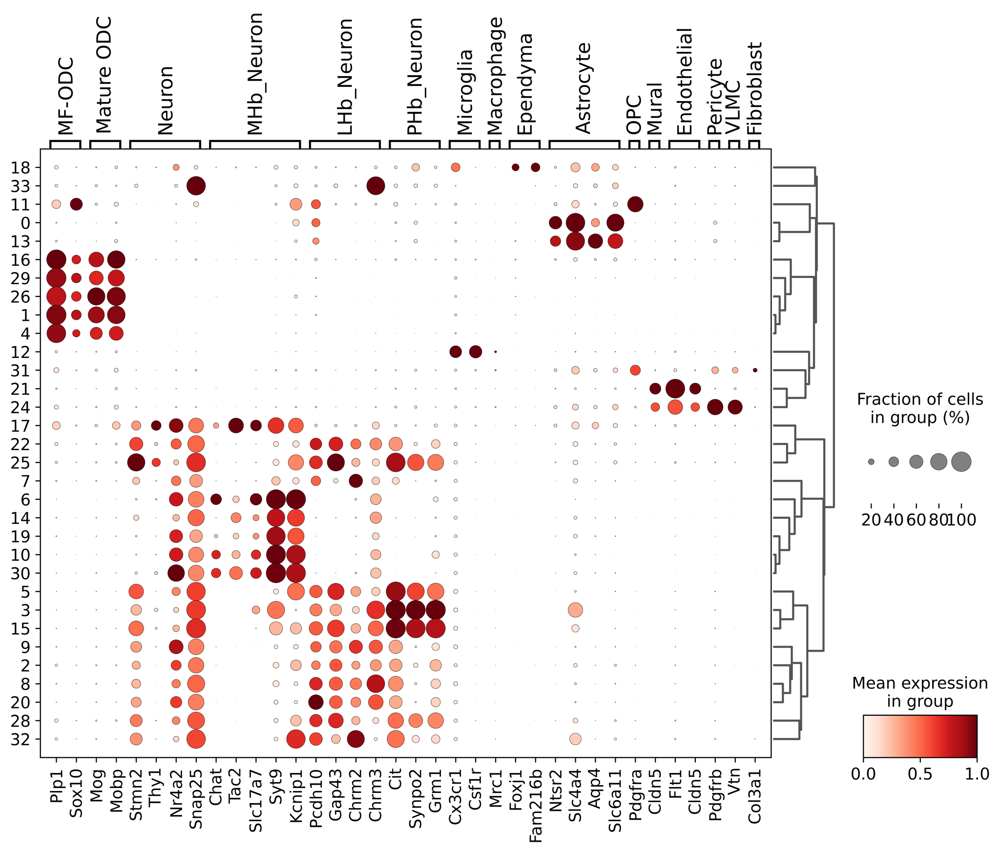

In [127]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,12), facecolor='white')

sc.tl.dendrogram(adata, 'leiden')

# marker genes from dotplot:
marker_dict = {
    'MF-ODC' : ['Plp1', 'Sox10'],
    'Mature ODC' : ['Mog', 'Mobp'],
    'Neuron' : ['Stmn2', 'Thy1', 'Nr4a2', 'Snap25', ],
    'MHb_Neuron': ['Chat', 'Tac2', 'Slc17a7', 'Syt9', 'Kcnip1'],
    'LHb_Neuron': ['Pcdh10', 'Gap43', 'Chrm2', 'Chrm3'],
    'PHb_Neuron': ['Cit', 'Synpo2', 'Grm1'],
    'Microglia': ['Cx3cr1', 'Csf1r'],
    'Macrophage': ['Mrc1'],
    'Ependyma':['Foxj1', 'Fam216b'],
    'Astrocyte' : ['Ntsr2', 'Slc4a4', 'Aqp4', 'Slc6a11'],
    'OPC' : ['Pdgfra'],
    'Mural' : ['Cldn5'],
    'Endothelial': ['Flt1', 'Cldn5'],
    'Pericyte': ['Pdgfrb'],
    'VLMC': ['Vtn'],
    'Fibroblast': ['Col3a1']
}

sc.pl.dotplot(adata, marker_dict, groupby='leiden', figsize=(12,8), standard_scale='var',  dendrogram=True)

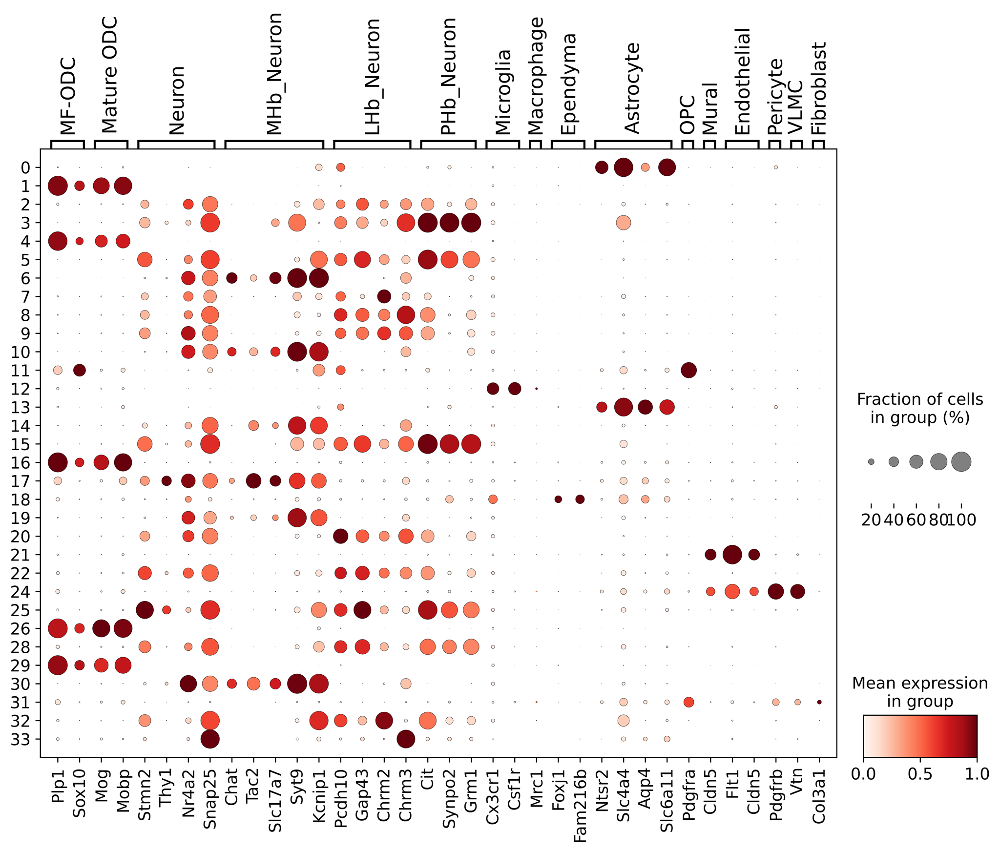

In [124]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,12), facecolor='white')

# marker genes from dotplot:
marker_dict = {
    'MF-ODC' : ['Plp1', 'Sox10'],
    'Mature ODC' : ['Mog', 'Mobp'],
    'Neuron' : ['Stmn2', 'Thy1', 'Nr4a2', 'Snap25', ],
    'MHb_Neuron': ['Chat', 'Tac2', 'Slc17a7', 'Syt9', 'Kcnip1'],
    'LHb_Neuron': ['Pcdh10', 'Gap43', 'Chrm2', 'Chrm3'],
    'PHb_Neuron': ['Cit', 'Synpo2', 'Grm1'],
    'Microglia': ['Cx3cr1', 'Csf1r'],
    'Macrophage': ['Mrc1'],
    'Ependyma':['Foxj1', 'Fam216b'],
    'Astrocyte' : ['Ntsr2', 'Slc4a4', 'Aqp4', 'Slc6a11'],
    'OPC' : ['Pdgfra'],
    'Mural' : ['Cldn5'],
    'Endothelial': ['Flt1', 'Cldn5'],
    'Pericyte': ['Pdgfrb'],
    'VLMC': ['Vtn'],
    'Fibroblast': ['Col3a1']
}

sc.pl.dotplot(adata, marker_dict, groupby='leiden', figsize=(12,8), standard_scale='var',  dendrogram=False)

In [109]:
# remove bad clusters
clusters_to_remove = [
    '27', '34', '23',
    
]


In [112]:
adata = adata[~adata.obs.leiden.isin(clusters_to_remove)].copy()

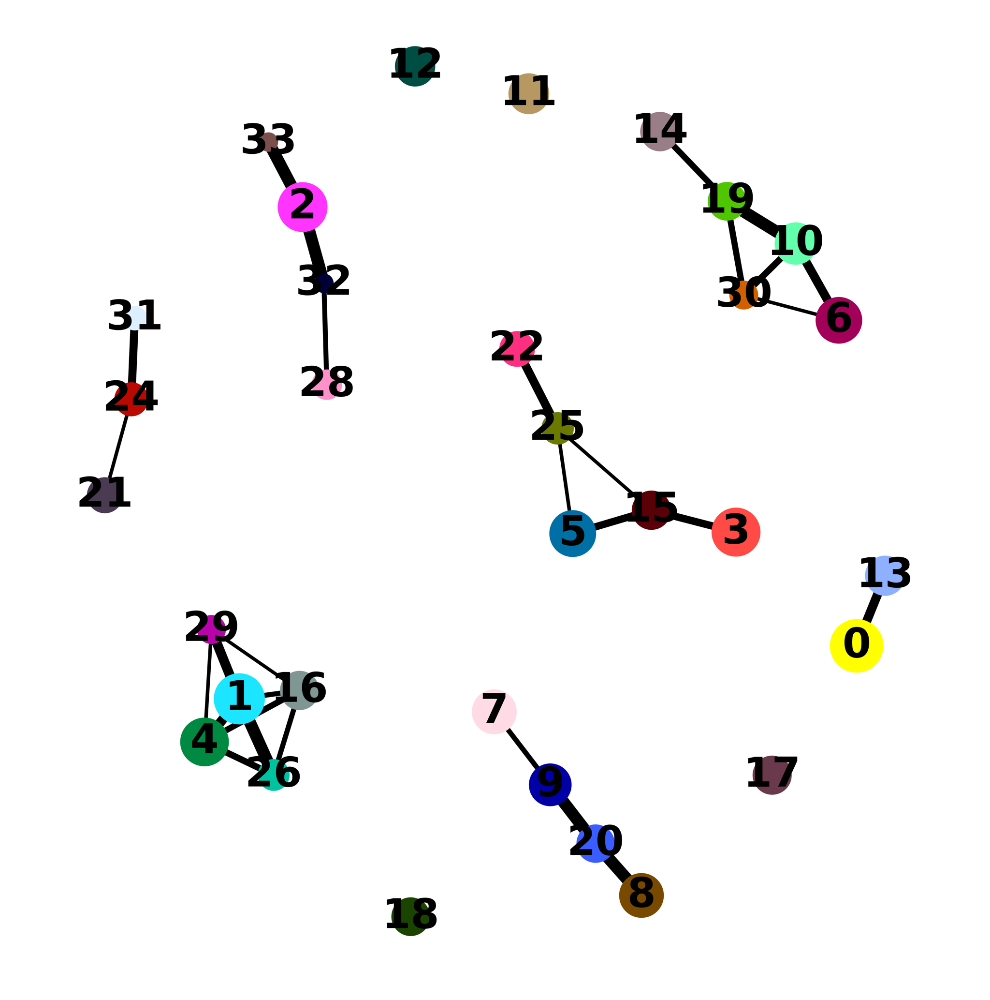

In [120]:
sc.settings.set_figure_params(dpi=500, dpi_save=200, figsize=(5,5), facecolor='white')
sc.tl.paga(adata)
sc.pl.paga(
    adata, threshold=0.2, title='', edge_width_scale=0.5,
    frameon=False, save=True
)

In [116]:
# re-compute UMAP using paga as initial position
sc.tl.umap(adata, min_dist=0.25, init_pos='paga')

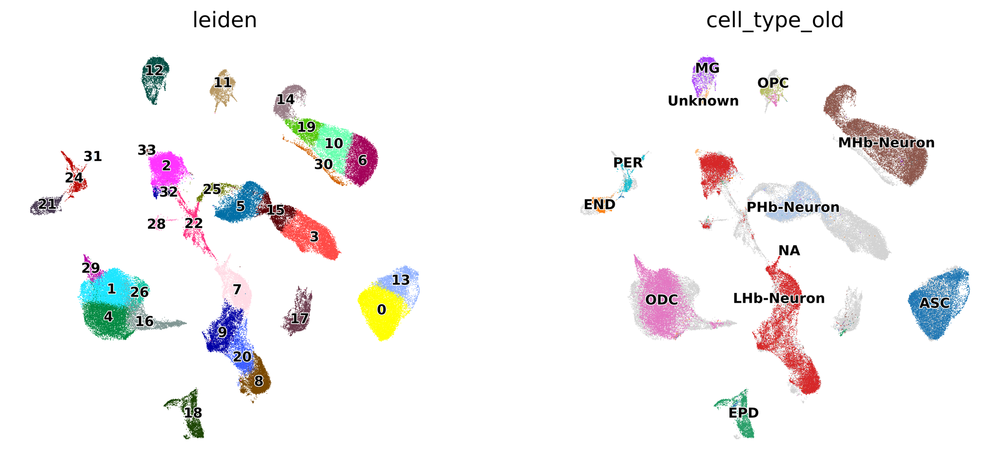

In [117]:
sc.settings.set_figure_params(dpi=500, dpi_save=200, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['leiden', 'cell_type_old'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    add_outline=False
)


In [118]:
adata.obs[adata.obs.leiden == '3'].Group.value_counts()

Nurr2c    2911
NN        2790
GFP       1608
NGFP      1127
Name: Group, dtype: int64

In [122]:
adata.obs.leiden.value_counts()

0     12380
1     10142
2      9098
3      8436
4      8234
5      6976
6      6857
7      5825
8      5733
9      4712
10     4548
11     3882
12     3672
13     3606
14     3329
15     3260
16     3248
17     3201
18     3055
19     3043
20     2951
21     2237
22     2145
24     1748
25     1404
26     1280
28     1058
29      846
30      841
31      403
32      137
33      132
Name: leiden, dtype: int64

## Broad cell type annotations

In [128]:
# load cluster anno df 
anno_df = pd.read_csv(
    '/dfs7/swaruplab/smorabit/collab/woodlab/cocaine_mouse_2021/data/April_2023/leiden_integrated.csv'
)



In [130]:
anno_df.leiden = anno_df.leiden.astype(str)
temp = adata.obs.merge(
    anno_df, how='left',
    on = 'leiden')
adata.obs['cell_type'] = temp['cell_type'].astype(str).to_list()
adata.obs['annotation'] = temp['annotation'].astype(str).to_list()


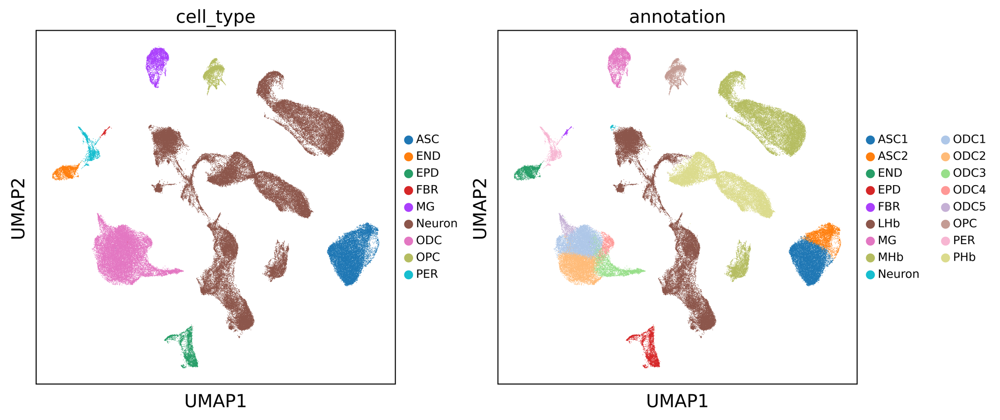

In [133]:
sc.settings.set_figure_params(dpi=500, dpi_save=200, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['cell_type', 'annotation'],
    legend_fontoutline=1, 
    legend_fontsize=9, 
    add_outline=False, 
)


In [134]:
adata.write('{}harmony_processed_integrated.h5ad'.format(data_dir))

## Subclustering analysis of the neurons

In [139]:
adata = sc.read_h5ad('{}harmony_processed_integrated.h5ad'.format(data_dir))

In [140]:
# subset neuronal cells:
adata_neuron = adata[adata.obs.cell_type == 'Neuron'].copy()
adata_neuron.X = adata_neuron.layers['counts'].copy()

In [141]:
sc.pp.highly_variable_genes(
    adata_neuron,
    flavor="seurat_v3",
    n_top_genes=3000,
    layer="counts",
    batch_key="Assignment",
    subset=False
)

In [142]:
sc.pp.scale(adata_neuron, max_value=10)

In [145]:
sc.tl.pca(adata_neuron, svd_solver='arpack', use_highly_variable=True)

In [146]:
sc.external.pp.harmony_integrate(adata_neuron, key = 'Assignment')

2023-04-17 16:27:04,935 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2023-04-17 16:27:31,841 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2023-04-17 16:27:57,934 - harmonypy - INFO - Iteration 3 of 10
INFO:harmonypy:Iteration 3 of 10
2023-04-17 16:28:24,765 - harmonypy - INFO - Iteration 4 of 10
INFO:harmonypy:Iteration 4 of 10
2023-04-17 16:28:50,554 - harmonypy - INFO - Iteration 5 of 10
INFO:harmonypy:Iteration 5 of 10
2023-04-17 16:29:16,159 - harmonypy - INFO - Iteration 6 of 10
INFO:harmonypy:Iteration 6 of 10
2023-04-17 16:29:41,841 - harmonypy - INFO - Iteration 7 of 10
INFO:harmonypy:Iteration 7 of 10
2023-04-17 16:30:01,655 - harmonypy - INFO - Iteration 8 of 10
INFO:harmonypy:Iteration 8 of 10
2023-04-17 16:30:27,122 - harmonypy - INFO - Iteration 9 of 10
INFO:harmonypy:Iteration 9 of 10
2023-04-17 16:30:48,157 - harmonypy - INFO - Iteration 10 of 10
INFO:harmonypy:Iteration 10 of 10
2023-04-17 16:31:08,028 - harmonypy - 

In [147]:
sc.pp.neighbors(adata_neuron, use_rep = 'X_pca_harmony', n_neighbors=15, n_pcs=30, metric='cosine')


In [148]:
sc.tl.umap(adata_neuron, min_dist=0.2, method='umap')

In [151]:
sc.tl.leiden(adata_neuron, resolution=0.75)

#compute dendrogram for the dotplot:
sc.tl.dendrogram(adata_neuron, 'leiden')

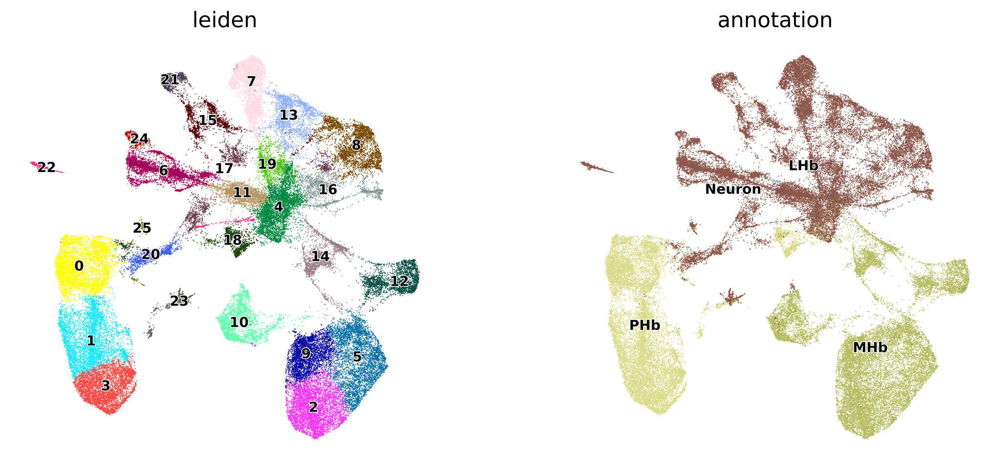

In [152]:
sc.settings.set_figure_params(dpi=500, dpi_save=200, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata_neuron, 
    color=['leiden', 'annotation'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    add_outline=False, 
  # save='_leiden_april2023.pdf'
)


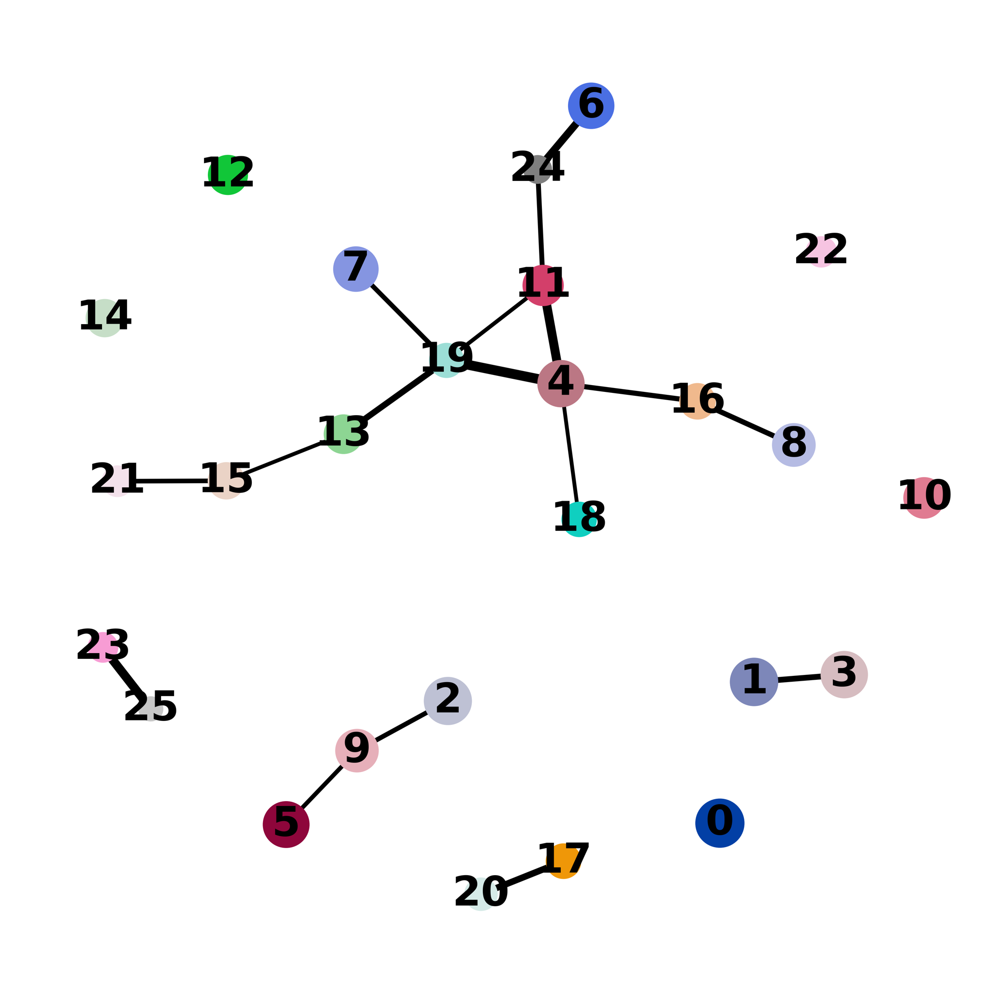

In [158]:
sc.settings.set_figure_params(dpi=500, dpi_save=200, figsize=(5,5), facecolor='white')
sc.tl.paga(adata_neuron)
sc.pl.paga(
    adata_neuron, threshold=0.3, title='', edge_width_scale=0.5,
    frameon=False
    #save='_neuronal_paga.pdf'
)


In [159]:
sc.tl.umap(adata_neuron, min_dist=0.25, init_pos='paga')

In [171]:
adata_neuron.obs.leiden.value_counts()

0     6038
1     5647
2     5513
3     5152
4     5102
5     4877
6     4708
7     4314
8     3642
9     3572
10    2936
11    2838
12    2516
13    2389
14    2053
15    1836
16    1670
17    1488
18    1454
19    1403
20    1137
21     890
22     852
23     767
24     578
25     314
Name: leiden, dtype: int64

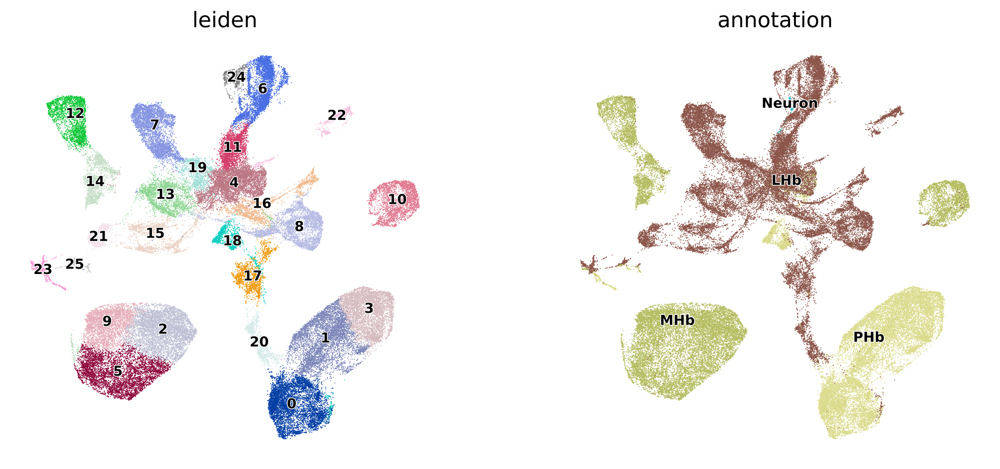

In [160]:
sc.settings.set_figure_params(dpi=500, dpi_save=200, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata_neuron, 
    color=['leiden', 'annotation'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    add_outline=False, 
  # save='_leiden_april2023.pdf'
)


categories: 0, 1, 2, etc.
var_group_labels: MF-ODC, Mature ODC, Neuron, etc.


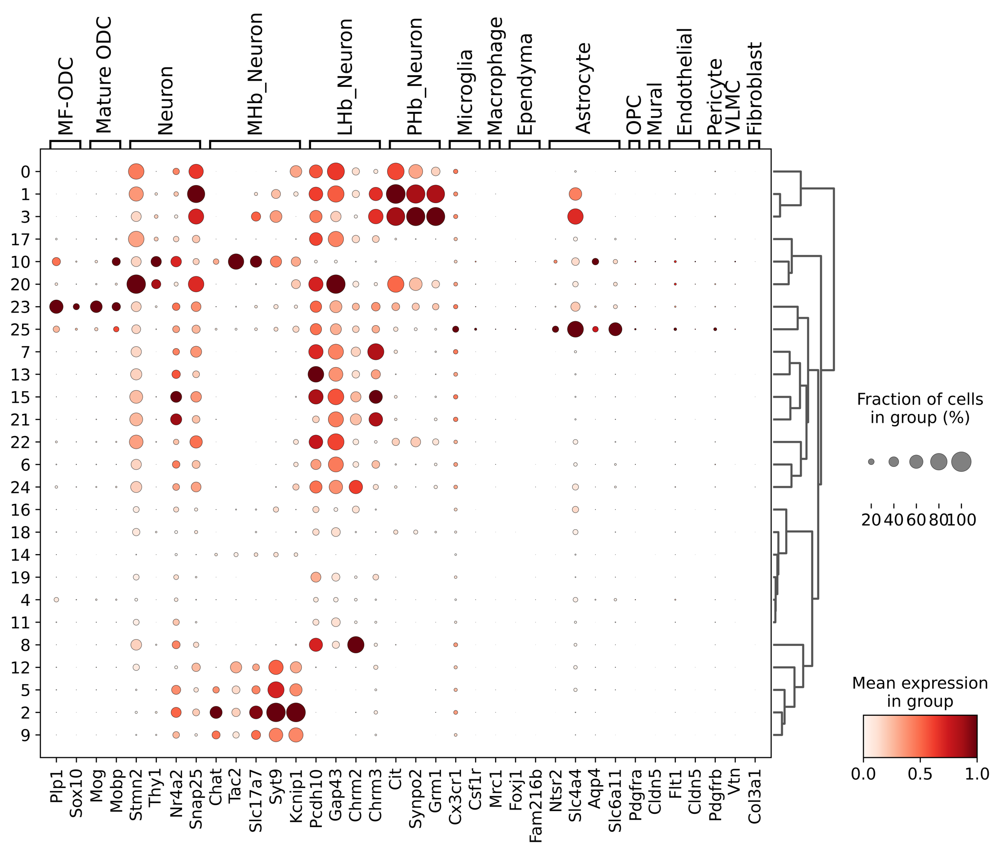

In [161]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,12), facecolor='white')

sc.tl.dendrogram(adata_neuron, 'leiden')

# marker genes from dotplot:
marker_dict = {
    'MF-ODC' : ['Plp1', 'Sox10'],
    'Mature ODC' : ['Mog', 'Mobp'],
    'Neuron' : ['Stmn2', 'Thy1', 'Nr4a2', 'Snap25', ],
    'MHb_Neuron': ['Chat', 'Tac2', 'Slc17a7', 'Syt9', 'Kcnip1'],
    'LHb_Neuron': ['Pcdh10', 'Gap43', 'Chrm2', 'Chrm3'],
    'PHb_Neuron': ['Cit', 'Synpo2', 'Grm1'],
    'Microglia': ['Cx3cr1', 'Csf1r'],
    'Macrophage': ['Mrc1'],
    'Ependyma':['Foxj1', 'Fam216b'],
    'Astrocyte' : ['Ntsr2', 'Slc4a4', 'Aqp4', 'Slc6a11'],
    'OPC' : ['Pdgfra'],
    'Mural' : ['Cldn5'],
    'Endothelial': ['Flt1', 'Cldn5'],
    'Pericyte': ['Pdgfrb'],
    'VLMC': ['Vtn'],
    'Fibroblast': ['Col3a1']
}

sc.pl.dotplot(adata_neuron, marker_dict, groupby='leiden', figsize=(12,8), standard_scale='var',  dendrogram=True)

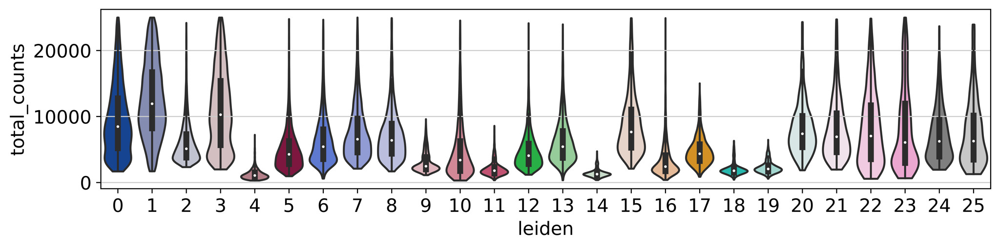

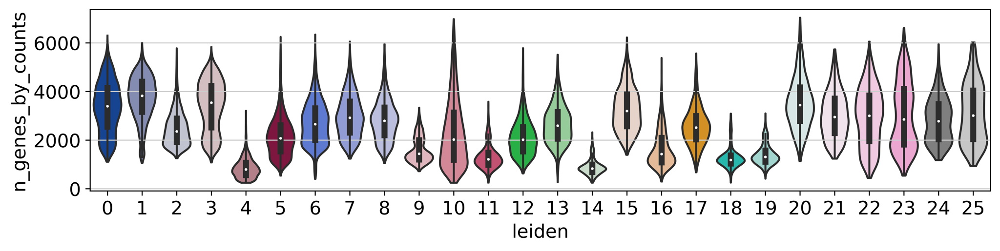

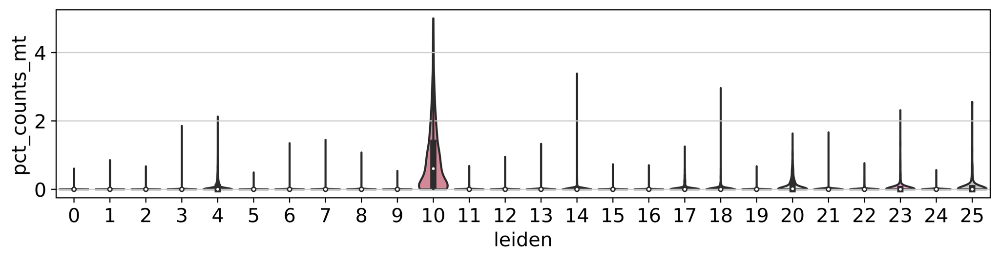

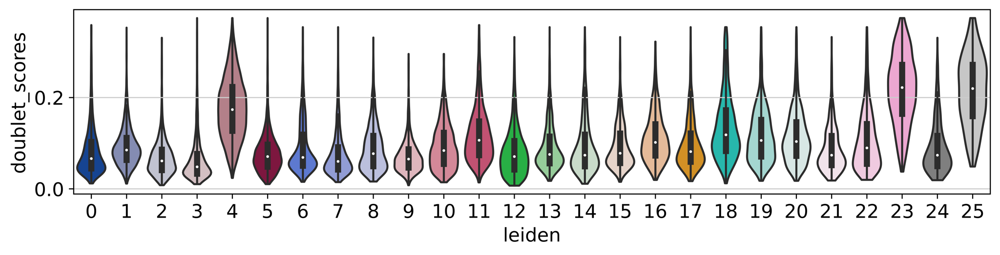

In [162]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata_neuron,[ 'total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False)
sc.pl.violin(adata_neuron,[ 'n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False)
sc.pl.violin(adata_neuron,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False)
sc.pl.violin(adata_neuron,[ 'doublet_scores'], inner='box', size=0,  groupby='leiden', multi_panel=False)

In [169]:
# remove bad clusters
clusters_to_remove = [
    '4',
    '11',
    '14',
    '18',
    '19',
    '23',
    '25'
]



/data/homezvol1/smorabit/swaruplab/smorabit/bin/software/alsppg_miniconda3/envs/torch/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


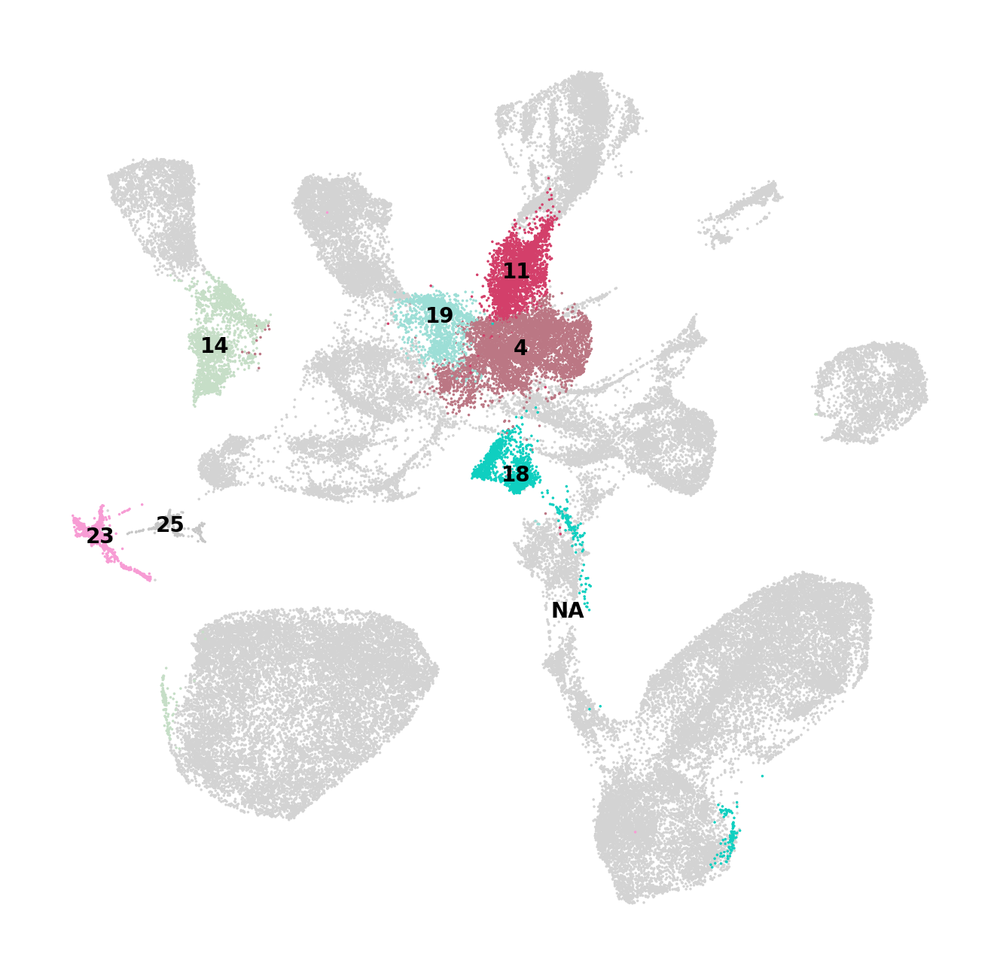

In [170]:
# clusters to remove based on low qc / conflicting markers
sc.settings.set_figure_params(dpi=200, figsize=(4,4), facecolor='white')
sc.pl.umap( 
    adata_neuron,
    color=["leiden"], 
    groups=clusters_to_remove,
    frameon=False, 
    legend_fontsize=5, 
    legend_loc='on data', 
    title=''
)


In [180]:
adata_neuron.obs[adata_neuron.obs.leiden == '11'].total_counts.mean()

2046.5917

In [173]:
adata_neuron.obs[adata_neuron.obs.leiden.isin(clusters_to_remove)].Group.value_counts()

NN        7256
NGFP      4871
Nurr2c    1189
GFP        615
Name: Group, dtype: int64

In [181]:
adata_neuron = adata_neuron[~adata_neuron.obs.leiden.isin(clusters_to_remove)]

In [182]:
adata_neuron.write('{}neuron_subcluster_integrated.h5ad'.format(data_dir))

## Re-process the subcluster data with additional filtering

In [184]:
adata_unprocessed = sc.read_h5ad('{}initial_unprocessed_integrated2023.h5ad'.format(data_dir))
adata_neuron = sc.read_h5ad('{}neuron_subcluster_integrated.h5ad'.format(data_dir))

In [185]:
adata_unprocessed = adata_unprocessed[adata_neuron.obs.index]
adata_unprocessed.obs = adata_neuron.obs
adata_neuron = adata_unprocessed


In [187]:
### Run processing again
sc.pp.normalize_total(adata_neuron, target_sum=1e4)
sc.pp.log1p(adata_neuron)
sc.pp.highly_variable_genes(adata_neuron, min_mean=0.0125, max_mean=3, min_disp=0.5)

In [188]:
sc.pp.scale(adata_neuron, max_value=10)

In [189]:
sc.tl.pca(adata_neuron, svd_solver='arpack', use_highly_variable=True)

In [190]:
sc.external.pp.harmony_integrate(adata_neuron, key = 'Assignment')

2023-04-18 10:06:48,004 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2023-04-18 10:07:07,871 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2023-04-18 10:07:27,725 - harmonypy - INFO - Iteration 3 of 10
INFO:harmonypy:Iteration 3 of 10
2023-04-18 10:07:47,713 - harmonypy - INFO - Converged after 3 iterations
INFO:harmonypy:Converged after 3 iterations


In [191]:
sc.pp.neighbors(adata_neuron, use_rep = 'X_pca_harmony', n_neighbors=15, n_pcs=30, metric='cosine')

In [192]:
sc.tl.umap(adata_neuron, min_dist=0.25, method='umap')

In [193]:
sc.tl.leiden(adata_neuron, resolution=0.75)

In [194]:
adata_neuron.obs.leiden.value_counts()

0     6571
1     6512
2     6357
3     4652
4     4614
5     4470
6     4397
7     3677
8     3215
9     2869
10    2826
11    2442
12    1903
13    1622
14    1322
15     875
16     755
17     390
18     182
19     104
Name: leiden, dtype: int64

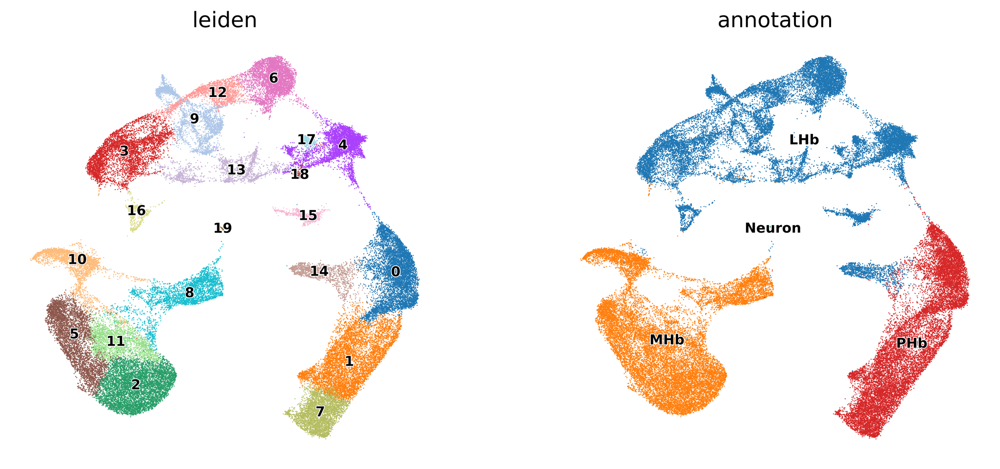

In [195]:
sc.settings.set_figure_params(dpi=500, dpi_save=200, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata_neuron, 
    color=['leiden', 'annotation'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    add_outline=False, 
  # save='_leiden_april2023.pdf'
)


categories: 0, 1, 2, etc.
var_group_labels: MF-ODC, Mature ODC, Neuron, etc.


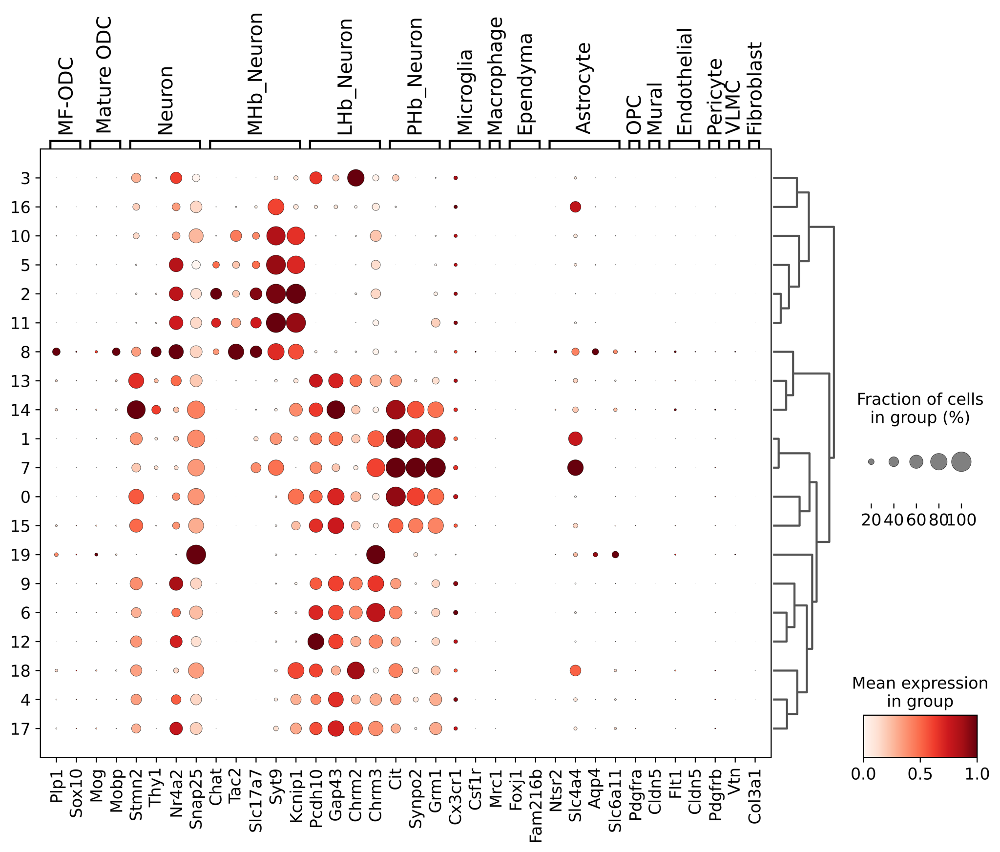

In [196]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,12), facecolor='white')

sc.tl.dendrogram(adata_neuron, 'leiden')

# marker genes from dotplot:
marker_dict = {
    'MF-ODC' : ['Plp1', 'Sox10'],
    'Mature ODC' : ['Mog', 'Mobp'],
    'Neuron' : ['Stmn2', 'Thy1', 'Nr4a2', 'Snap25', ],
    'MHb_Neuron': ['Chat', 'Tac2', 'Slc17a7', 'Syt9', 'Kcnip1'],
    'LHb_Neuron': ['Pcdh10', 'Gap43', 'Chrm2', 'Chrm3'],
    'PHb_Neuron': ['Cit', 'Synpo2', 'Grm1'],
    'Microglia': ['Cx3cr1', 'Csf1r'],
    'Macrophage': ['Mrc1'],
    'Ependyma':['Foxj1', 'Fam216b'],
    'Astrocyte' : ['Ntsr2', 'Slc4a4', 'Aqp4', 'Slc6a11'],
    'OPC' : ['Pdgfra'],
    'Mural' : ['Cldn5'],
    'Endothelial': ['Flt1', 'Cldn5'],
    'Pericyte': ['Pdgfrb'],
    'VLMC': ['Vtn'],
    'Fibroblast': ['Col3a1']
}

sc.pl.dotplot(adata_neuron, marker_dict, groupby='leiden', figsize=(12,8), standard_scale='var',  dendrogram=True)

In [199]:
# load cluster anno df 
anno_df = pd.read_csv(
    '/dfs7/swaruplab/smorabit/collab/woodlab/cocaine_mouse_2021/data/April_2023/neuron_leiden.csv'
)

anno_df.leiden = anno_df.leiden.astype(str)
anno_df.head()

,leiden,cell_type,annotation
0,0,PHb-Neuron,PHb-1
1,1,PHb-Neuron,PHb-2
2,2,MHb-Neuron,MHb-1
3,3,LHb-Neuron,LHb-1
4,4,LHb-Neuron,LHb-2


In [206]:
adata_neuron.obs = adata_neuron.obs.drop('cell_type',axis=1)

temp = adata_neuron.obs.merge(
    anno_df, how='left',
    on = 'leiden')
adata_neuron.obs['cell_type'] = temp['cell_type'].astype(str).to_list()
adata_neuron.obs['annotation'] = temp['annotation_y'].astype(str).to_list()
adata_neuron.obs


,doublet_scores,Sample,barcode,Assignment,Group,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_old,cell_type_old,batch,leiden,annotation,cell_type
ATAGAGATCCGCACTT-1-0-0,0.133940,Sample-1,ATAGAGATCCGCACTT-1-0,Group1,Nurr2c,5863,22094.0,0.0,0.000000,9,NaN,0,3,LHb-1,LHb-Neuron
AGAGCAGCAGACGGAT-1-0-0,0.108108,Sample-1,AGAGCAGCAGACGGAT-1-0,Group1,Nurr2c,6068,22372.0,0.0,0.000000,4,NaN,0,14,PHb-4,PHb-Neuron
ACCTACCAGTCTGTAC-1-0-0,0.108108,Sample-1,ACCTACCAGTCTGTAC-1-0,Group1,Nurr2c,5411,22398.0,0.0,0.000000,9,NaN,0,3,LHb-1,LHb-Neuron
GTCATTTTCAGCAGAG-1-0-0,0.055556,Sample-1,GTCATTTTCAGCAGAG-1-0,Group1,Nurr2c,5272,22134.0,0.0,0.000000,4,NaN,0,1,PHb-2,PHb-Neuron
GCACGGTTCCTCACCA-1-0-0,0.022490,Sample-1,GCACGGTTCCTCACCA-1-0,Group1,Nurr2c,5271,22228.0,0.0,0.000000,4,NaN,0,0,PHb-1,PHb-Neuron
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGCTGCCATTAGGCT-1-7-1,0.093100,Group3-2,TTGCTGCCATTAGGCT-1-7,Group3,NN,619,824.0,5.0,0.606796,NaN,NaN,1,8,MHb-3,MHb-Neuron
TAGTGCATCTCTATAC-1-7-1,0.127860,Group3-2,TAGTGCATCTCTATAC-1-7,Group3,NN,607,763.0,3.0,0.393185,NaN,NaN,1,8,MHb-3,MHb-Neuron
TTAATCCTCCGTAGTA-1-7-1,0.023838,Group3-2,TTAATCCTCCGTAGTA-1-7,Group3,NN,477,640.0,6.0,0.937500,NaN,NaN,1,8,MHb-3,MHb-Neuron
GTATTTCTCCGATCTC-1-7-1,0.046177,Group3-2,GTATTTCTCCGATCTC-1-7,Group3,NN,404,544.0,5.0,0.919118,NaN,NaN,1,8,MHb-3,MHb-Neuron


In [208]:
adata_neuron = adata_neuron[adata_neuron.obs.cell_type != 'Doublet'].copy()

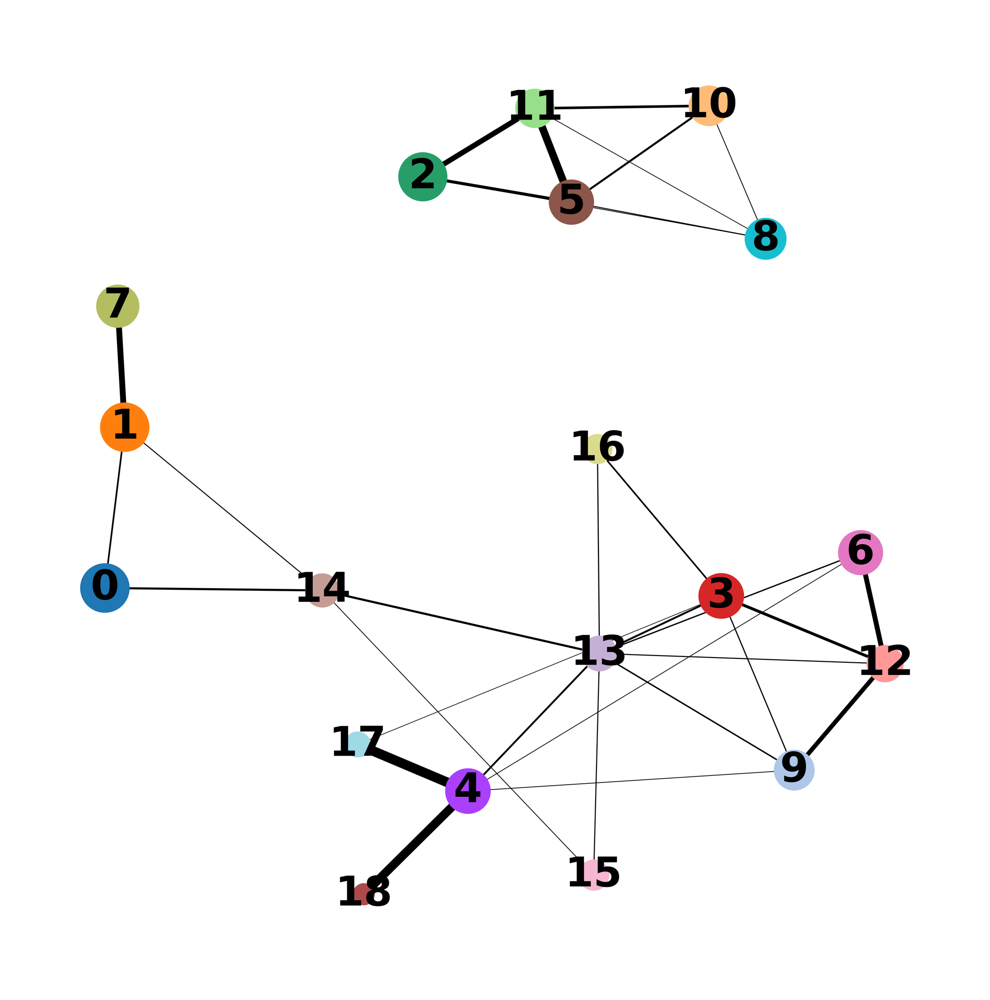

In [217]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.tl.paga(adata_neuron)
sc.pl.paga(
    adata_neuron, threshold=0.05, title='', edge_width_scale=0.5,
    frameon=False, save='_neuronal_paga.pdf'
)


In [218]:
sc.tl.umap(adata_neuron, min_dist=0.25, init_pos='paga')

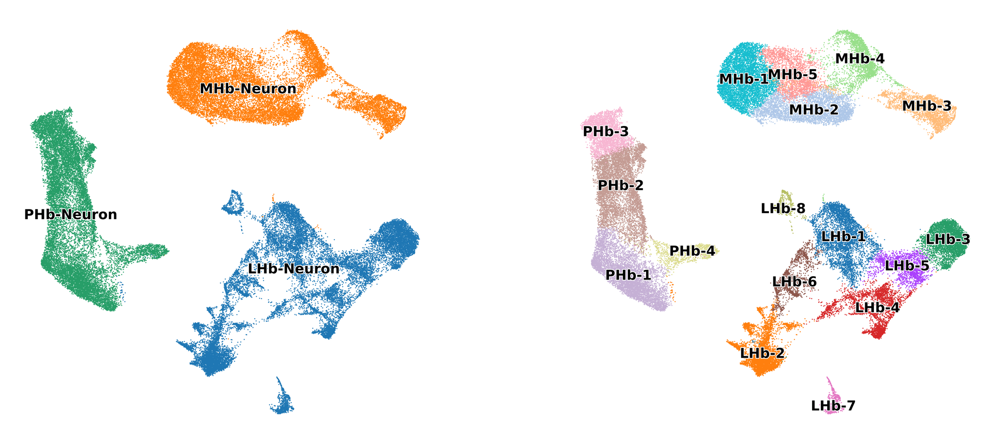

In [219]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata_neuron, 
    color=['cell_type', 'annotation'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    add_outline=False, 
    title=['', '']
)


In [221]:
adata_neuron.obs['neuron_UMAP_1'] = adata_neuron.obsm['X_umap'][:,0]
adata_neuron.obs['neuron_UMAP_2'] = adata_neuron.obsm['X_umap'][:,1]


In [222]:
# save data with the cluster labels:
adata_neuron.write('{}neuronal_processed_integrated.h5ad'.format(data_dir))
adata_neuron.obs.to_csv('{}neuronal_processed_cell_meta_integrated.csv'.format(data_dir))

In [4]:
adata_neuron = sc.read_h5ad('{}neuronal_processed_integrated.h5ad'.format(data_dir))

/data/homezvol1/smorabit/swaruplab/smorabit/bin/software/alsppg_miniconda3/envs/torch/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


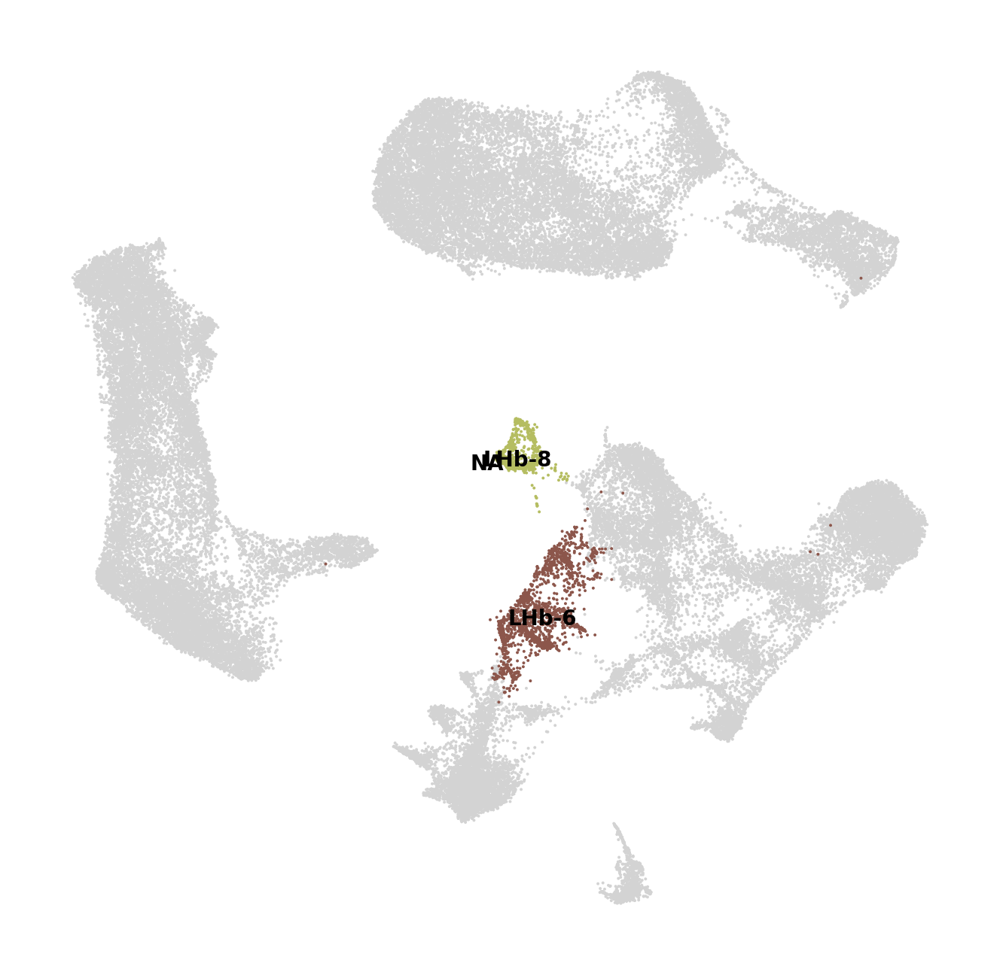

In [6]:
# remove clusters 6 & 8 as outliers:

# remove bad clusters
clusters_to_remove = [
    'LHb-6', 'LHb-8'
]
# clusters to remove based on low qc / conflicting markers
sc.settings.set_figure_params(dpi=200, figsize=(4,4), facecolor='white')
sc.pl.umap( 
    adata_neuron,
    color=["annotation"], 
    groups=clusters_to_remove,
    frameon=False, 
    legend_fontsize=5, 
    legend_loc='on data', 
    title=''
)


## add neuronal subclusters to the full dataset

In [224]:
adata_full = adata.copy()

In [223]:
neuron_meta = adata_neuron.obs[['leiden', 'cell_type', 'annotation', 'neuron_UMAP_1', 'neuron_UMAP_2']]
neuron_meta = neuron_meta.rename({
    'leiden':'neuron_leiden',
    'cell_type':'neuron_type'
}, axis=1)
neuron_meta.head()

,neuron_leiden,neuron_type,annotation,neuron_UMAP_1,neuron_UMAP_2
ATAGAGATCCGCACTT-1-0-0,3,LHb-Neuron,LHb-1,8.417749,1.577956
AGAGCAGCAGACGGAT-1-0-0,14,PHb-Neuron,PHb-4,-0.493666,2.128532
ACCTACCAGTCTGTAC-1-0-0,3,LHb-Neuron,LHb-1,9.566876,1.037260
GTCATTTTCAGCAGAG-1-0-0,1,PHb-Neuron,PHb-2,-2.187417,2.986369
GCACGGTTCCTCACCA-1-0-0,0,PHb-Neuron,PHb-1,-2.116566,0.316993


In [230]:
# transfer metadata
temp = adata.obs.merge(
    neuron_meta, how='left',
    left_index=True, right_index=True
)
temp.shape



(128419, 20)

In [232]:
temp.head()

,doublet_scores,Sample,barcode,Assignment,Group,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_old,cell_type_old,batch,leiden,cell_type,annotation_x,neuron_leiden,neuron_type,annotation_y,neuron_UMAP_1,neuron_UMAP_2
ATAGAGATCCGCACTT-1-0-0,0.133940,Sample-1,ATAGAGATCCGCACTT-1-0,Group1,Nurr2c,5863,22094.0,0.0,0.0,9,NaN,0,9,Neuron,LHb,3,LHb-Neuron,LHb-1,8.417749,1.577956
AGAGCAGCAGACGGAT-1-0-0,0.108108,Sample-1,AGAGCAGCAGACGGAT-1-0,Group1,Nurr2c,6068,22372.0,0.0,0.0,4,NaN,0,25,Neuron,LHb,14,PHb-Neuron,PHb-4,-0.493666,2.128532
ACCTACCAGTCTGTAC-1-0-0,0.108108,Sample-1,ACCTACCAGTCTGTAC-1-0,Group1,Nurr2c,5411,22398.0,0.0,0.0,9,NaN,0,9,Neuron,LHb,3,LHb-Neuron,LHb-1,9.566876,1.037260
GTCATTTTCAGCAGAG-1-0-0,0.055556,Sample-1,GTCATTTTCAGCAGAG-1-0,Group1,Nurr2c,5272,22134.0,0.0,0.0,4,NaN,0,15,Neuron,PHb,1,PHb-Neuron,PHb-2,-2.187417,2.986369
GCACGGTTCCTCACCA-1-0-0,0.022490,Sample-1,GCACGGTTCCTCACCA-1-0,Group1,Nurr2c,5271,22228.0,0.0,0.0,4,NaN,0,5,Neuron,PHb,0,PHb-Neuron,PHb-1,-2.116566,0.316993


In [229]:
adata.shape

(128419, 32285)

In [231]:
adata.obs = temp
adata.obs.index.name = None

In [244]:


# upadte cell type column
adata.obs['cell_type'] = np.where(
    adata.obs.cell_type.isin(['Neuron']),
    adata.obs.neuron_type,
    adata.obs.cell_type
)



In [246]:
# set annotation
adata.obs['annotation'] = np.where(
    adata.obs.cell_type.isin(['MHb-Neuron', 'LHb-Neuron', 'PHb-Neuron']),
    adata.obs.annotation_y,
    adata.obs.annotation_x
)

In [259]:
adata = adata[~adata.obs.annotation.isin(['Neuron', 'LHb', 'PHb', 'MHb'])].copy()
adata.shape

(114384, 32285)

In [260]:
adata.obs.Assignment.value_counts()

Group3    59413
Group1    31157
Group2    23814
Name: Assignment, dtype: int64

In [261]:
adata.obs[adata.obs.cell_type.isin(['MHb-Neuron', 'PHb-Neuron', 'LHb-Neuron'])].shape

(59651, 21)

In [262]:
adata_neuron.shape

(59651, 32285)

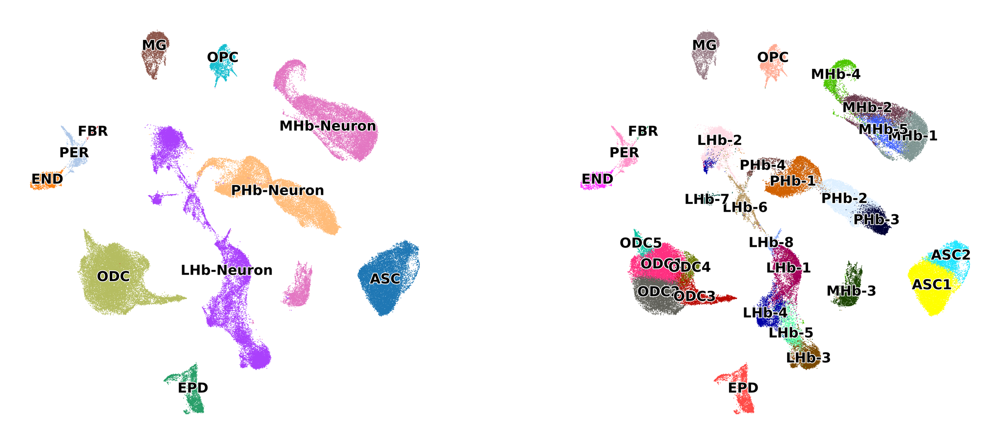

In [263]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['cell_type', 'annotation'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    add_outline=False, 
    title=['', ''], 
)


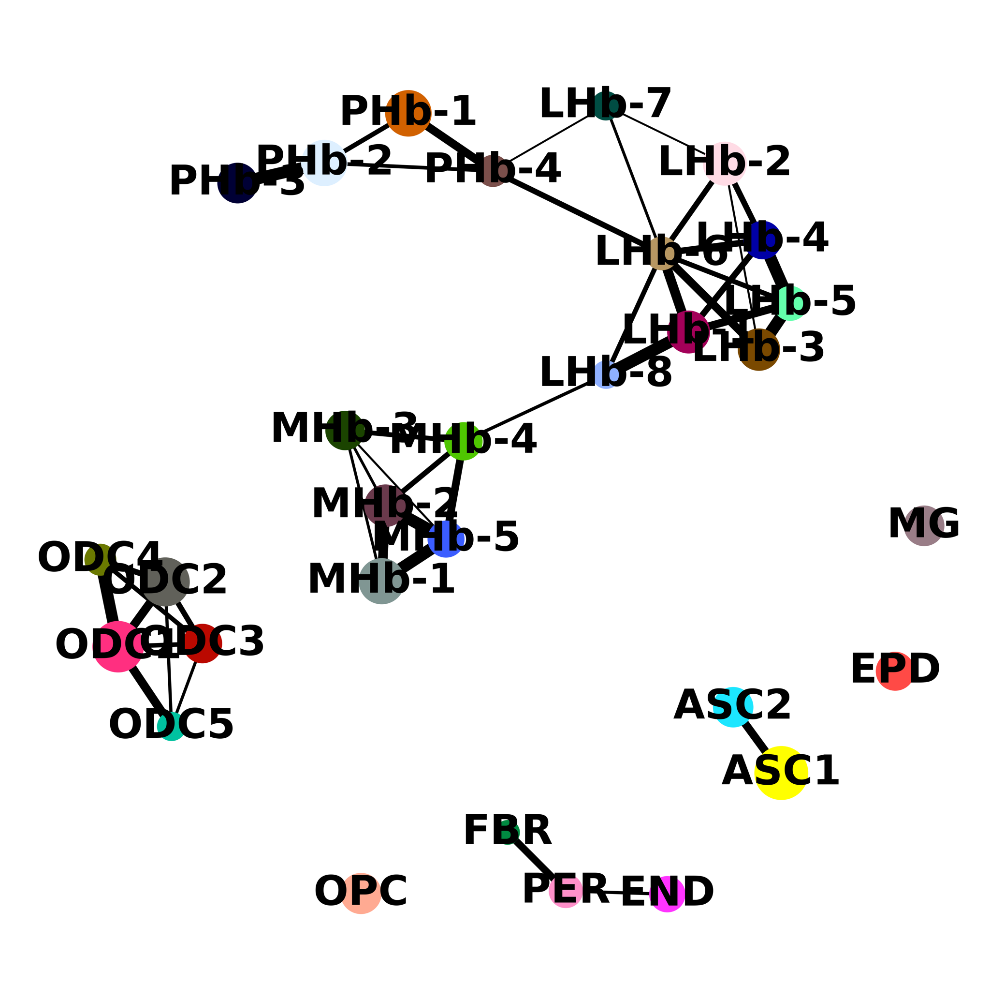

In [267]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.tl.paga(adata, groups='annotation')
sc.pl.paga(
    adata, 
    #labels = 'annotation', 
    threshold=0.15, title='', edge_width_scale=0.5,
    frameon=False,
)


In [268]:
sc.tl.umap(adata, min_dist=0.25, init_pos='paga')

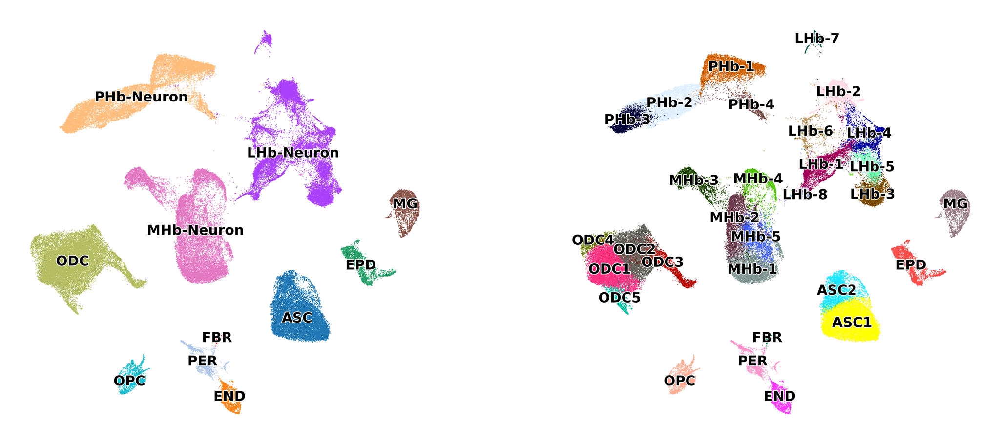

In [269]:
sc.tl.umap(adata, min_dist=0.25, init_pos='paga')

sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['cell_type', 'annotation'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    add_outline=False, 
    title=['', ''], 
)


In [32]:
adata.obs['UMAP_1'] = adata.obsm['X_umap'][:,0]
adata.obs['UMAP_2'] = adata.obsm['X_umap'][:,1]


## Remove clusters that are misrepresented across samples

/data/homezvol1/smorabit/swaruplab/smorabit/bin/software/alsppg_miniconda3/envs/torch/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


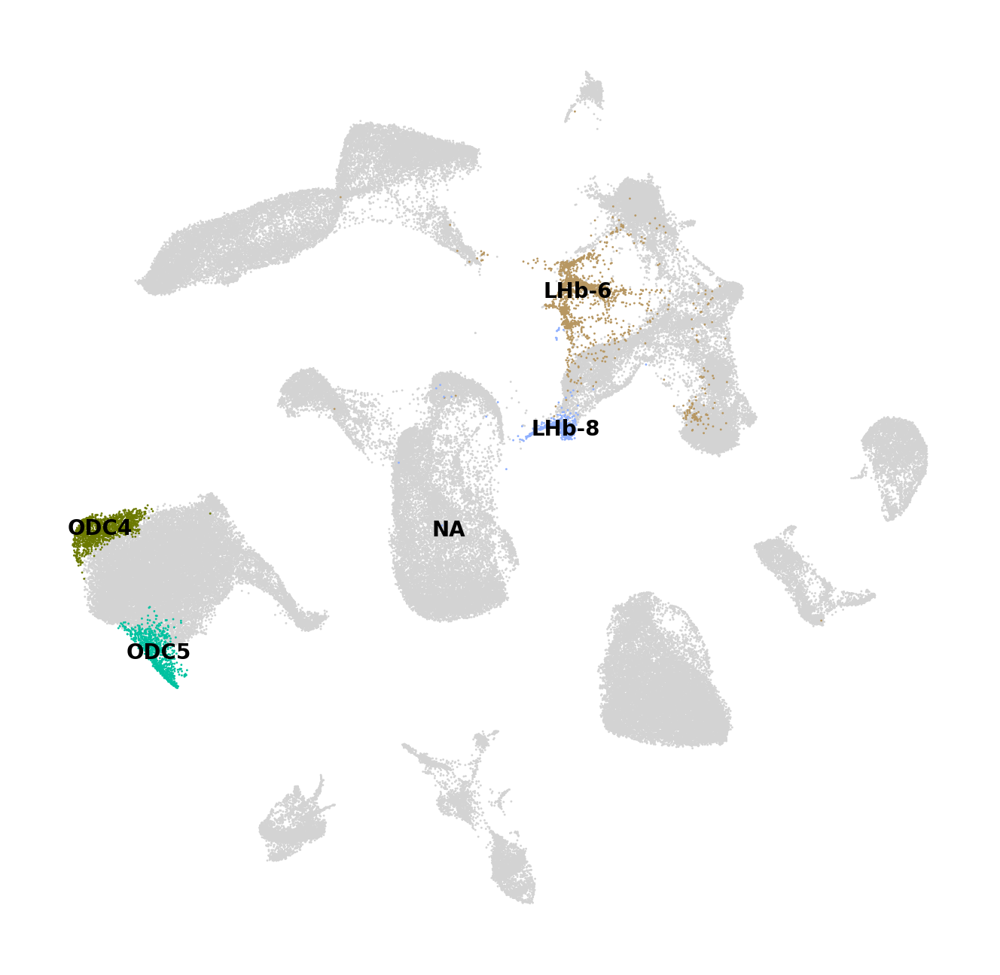

In [7]:
# remove clusters 6 & 8 as outliers:

# remove bad clusters
clusters_to_remove = [
    'LHb-6', 'LHb-8', 'ODC4', 'ODC5'
]
# clusters to remove based on low qc / conflicting markers
sc.settings.set_figure_params(dpi=200, figsize=(4,4), facecolor='white')
sc.pl.umap( 
    adata,
    color=["annotation"], 
    groups=clusters_to_remove,
    frameon=False, 
    legend_fontsize=5, 
    legend_loc='on data', 
    title=''
)


In [8]:
adata = adata[~adata.obs.annotation.isin(clusters_to_remove)]

In [23]:
adata.obs['annotation'] = adata.obs.annotation.replace(to_replace={"LHb-7":'LHb-6'})

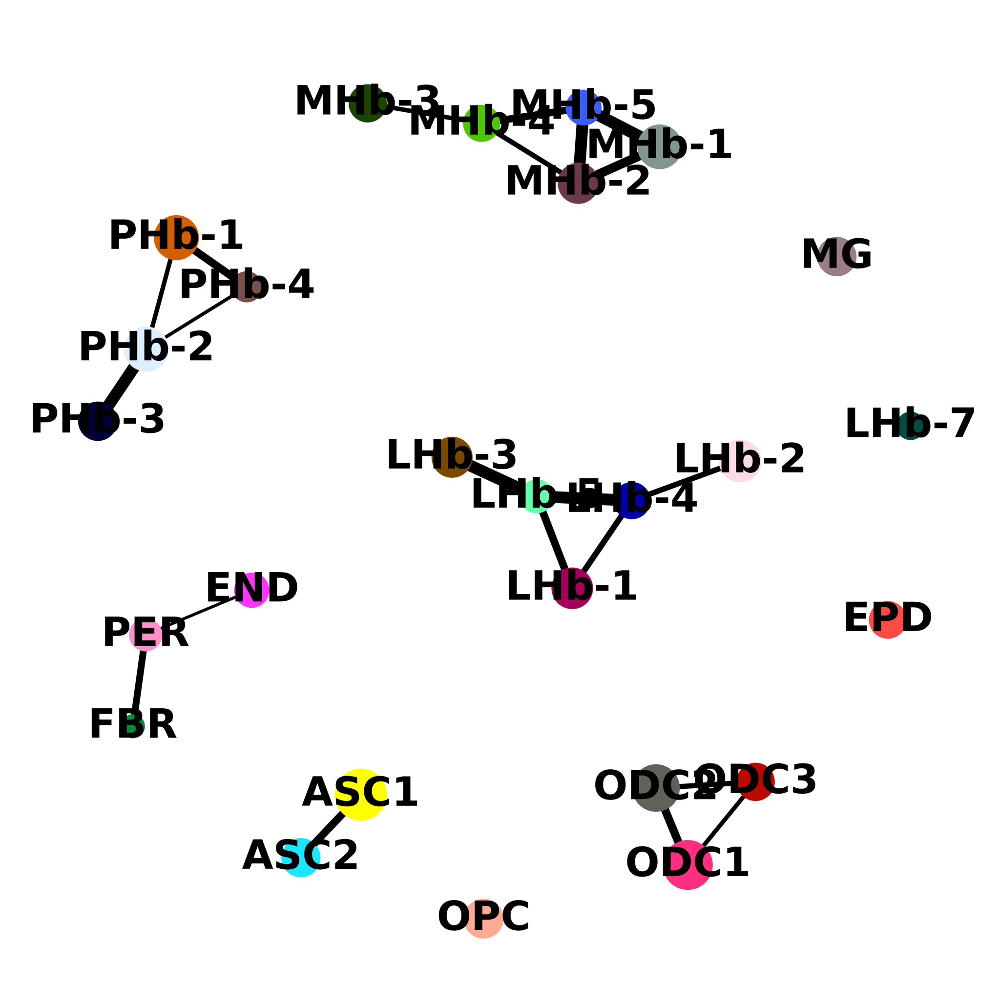

In [17]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.tl.paga(adata, groups='annotation')
sc.pl.paga(
    adata, 
    #labels = 'annotation', 
    threshold=0.25, title='', edge_width_scale=0.5,
    frameon=False,
)


In [14]:
sc.tl.umap(adata, min_dist=0.25, init_pos='paga')


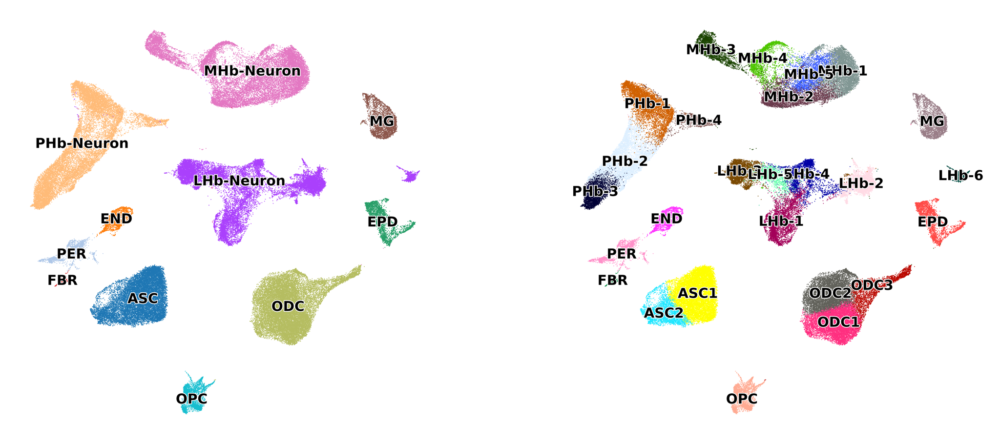

In [24]:

sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['cell_type', 'annotation'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    add_outline=False, 
    title=['', ''], 
)


In [ ]:
adata.obs['UMAP_1'] = adata.obsm['X_umap'][:,0]
adata.obs['UMAP_2'] = adata.obsm['X_umap'][:,1]


categories: ASC1, ASC2, END, etc.
var_group_labels: MF-ODC, Mature ODC, Neuron, etc.


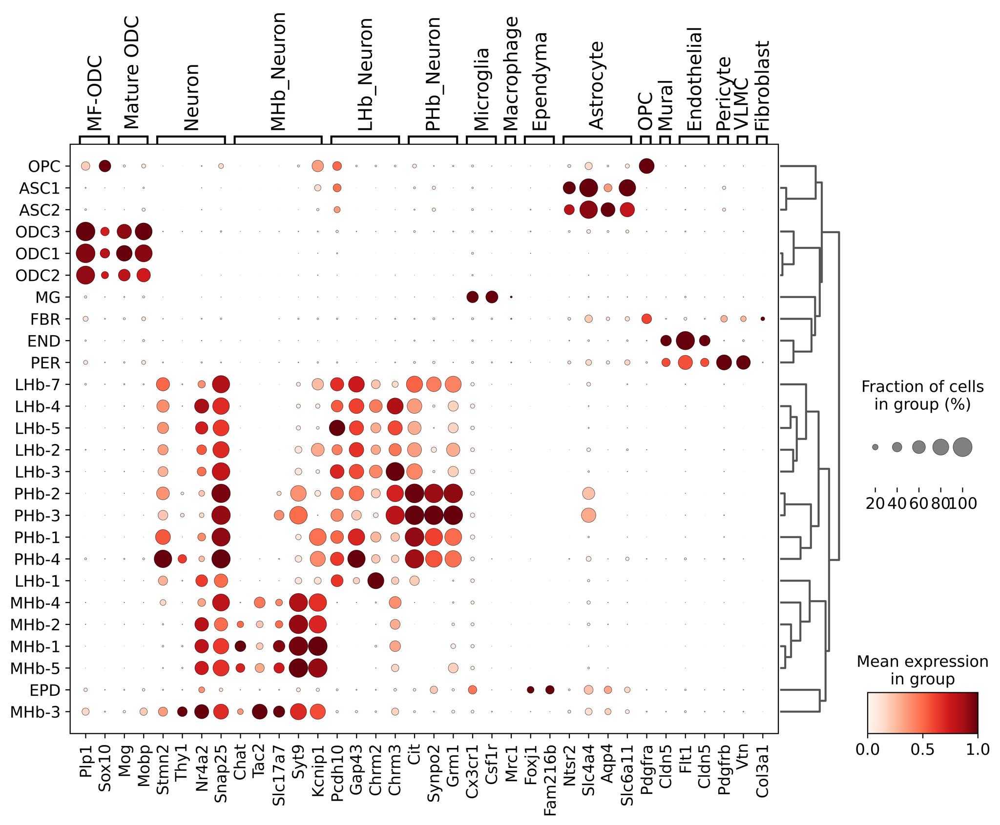

In [19]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,12), facecolor='white')

sc.tl.dendrogram(adata, 'annotation')

# marker genes from dotplot:
marker_dict = {
    'MF-ODC' : ['Plp1', 'Sox10'],
    'Mature ODC' : ['Mog', 'Mobp'],
    'Neuron' : ['Stmn2', 'Thy1', 'Nr4a2', 'Snap25', ],
    'MHb_Neuron': ['Chat', 'Tac2', 'Slc17a7', 'Syt9', 'Kcnip1'],
    'LHb_Neuron': ['Pcdh10', 'Gap43', 'Chrm2', 'Chrm3'],
    'PHb_Neuron': ['Cit', 'Synpo2', 'Grm1'],
    'Microglia': ['Cx3cr1', 'Csf1r'],
    'Macrophage': ['Mrc1'],
    'Ependyma':['Foxj1', 'Fam216b'],
    'Astrocyte' : ['Ntsr2', 'Slc4a4', 'Aqp4', 'Slc6a11'],
    'OPC' : ['Pdgfra'],
    'Mural' : ['Cldn5'],
    'Endothelial': ['Flt1', 'Cldn5'],
    'Pericyte': ['Pdgfrb'],
    'VLMC': ['Vtn'],
    'Fibroblast': ['Col3a1']
}

sc.pl.dotplot(adata, marker_dict, groupby='annotation', figsize=(12,8), standard_scale='var',  dendrogram=True)

## Save the final annotated dataset!

In [25]:
# remove meta-data columns that we don't need:
adata.obs = adata.obs.drop(['annotation_x', 'annotation_y', 'neuron_type', 'leiden_old'], axis=1)

KeyError: "['annotation_x', 'annotation_y', 'neuron_type', 'leiden_old'] not found in axis"

In [33]:
# save the annotated data object
adata.write('{}harmony_annotated_integration.h5ad'.format(data_dir))


In [34]:
#adata = sc.read_h5ad('{}harmony_annotated_integration.h5ad'.format(data_dir))

In [35]:
# write the obs and var tables:
adata.obs.to_csv('{}harmony_annotated_integration_cell_meta.csv'.format(data_dir))
adata.var.to_csv('{}harmony_annotated_integration_gene_meta.csv'.format(data_dir))


In [28]:
adata.obs.columns

Index(['doublet_scores', 'Sample', 'barcode', 'Assignment', 'Group',
       'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt',
       'cell_type_old', 'batch', 'leiden', 'cell_type', 'neuron_leiden',
       'neuron_UMAP_1', 'neuron_UMAP_2', 'annotation', 'UMAP_1', 'UMAP_2'],
      dtype='object')

In [29]:
# write the latent representation:
pd.DataFrame(adata.obsm['X_pca_harmony']).to_csv('{}harmony_annotated_integration_harmony.csv'.format(data_dir))

In [30]:
# get counts matrix for Seurat:
adata_unf = sc.read_h5ad('{}initial_unprocessed_integrated2023.h5ad'.format(data_dir))
adata_unf = adata_unf[adata.obs.index]
X = adata_unf.X
X.shape

(109881, 32285)

In [31]:
# write counts mat
import scipy
from scipy import io
from scipy.sparse import coo_matrix, csr_matrix

X = scipy.sparse.csr_matrix.transpose(X)
io.mmwrite('{}harmony_annotated_integration_counts.mtx'.format(data_dir), X)